<a href="https://colab.research.google.com/github/Whitchurch/CNNTensorflowCode/blob/main/homework4_WhitchurchMuthumani_1201000727.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!sudo apt-get update -y
!sudo apt-get install python3.10

Get:1 https://cloud.r-project.org/bin/linux/ubuntu focal-cran40/ InRelease [3,622 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease [1,581 B]
Get:3 http://security.ubuntu.com/ubuntu focal-security InRelease [114 kB]
Hit:4 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu focal InRelease
Hit:5 http://archive.ubuntu.com/ubuntu focal InRelease
Get:6 http://archive.ubuntu.com/ubuntu focal-updates InRelease [114 kB]
Hit:7 http://ppa.launchpad.net/cran/libgit2/ubuntu focal InRelease
Get:8 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  Packages [993 kB]
Hit:9 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu focal InRelease
Hit:10 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu focal InRelease
Get:11 http://archive.ubuntu.com/ubuntu focal-backports InRelease [108 kB]
Hit:12 http://ppa.launchpad.net/ubuntugis/ppa/ubuntu focal InRelease
Get:13 http://security.ubuntu.com/ubuntu focal-security/universe amd64 Packages [

In [2]:
import numpy as np
import cv2
import glob
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from PIL import Image

In [3]:
!mkdir images

#Start loading all the images into the folder from my personal githum repo
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left01.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left02.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left03.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left04.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left05.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left06.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left07.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left08.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left09.jpg -P images/
#!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left10.jpg -P sample_data/images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left11.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left12.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left13.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left14.jpg -P images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left15.jpg -P images/


https://: Invalid host name.
--2023-04-21 14:27:41--  http://raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left01.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left01.jpg [following]
--2023-04-21 14:27:41--  https://raw.githubusercontent.com/Whitchurch/checkerboardimages/main/left01.jpg
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 27908 (27K) [image/jpeg]
Saving to: ‘images/left01.jpg’

left01.jpg          100%[===================>]  27.25K  --.-KB/s    in 0.003s  

2023-04-21 14:27:42 (8.80 MB/s) - ‘images/left01.jpg’ saved [27908/27908]

FIN

# SECTION 1: (using 8x6 as specified in the assignment) 
*   8x6 Pattern (originally given in assignment)







In [4]:

# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*8,3), np.float32)
objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the left_images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

# TODO Part A (1): load the list of images in images using glob or any other function.
path = 'images/*.jpg'
images = glob.glob(path)
print(images)


['images/left03.jpg', 'images/left08.jpg', 'images/left05.jpg', 'images/left06.jpg', 'images/left14.jpg', 'images/left13.jpg', 'images/left04.jpg', 'images/left09.jpg', 'images/left01.jpg', 'images/left11.jpg', 'images/left02.jpg', 'images/left15.jpg', 'images/left07.jpg', 'images/left12.jpg']


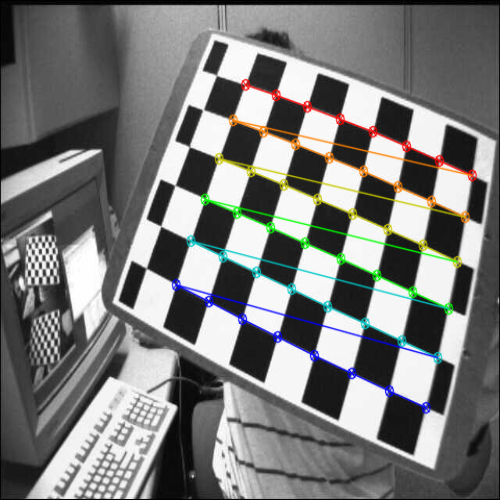

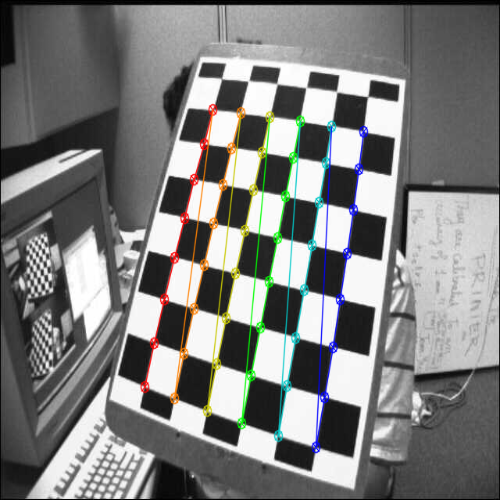

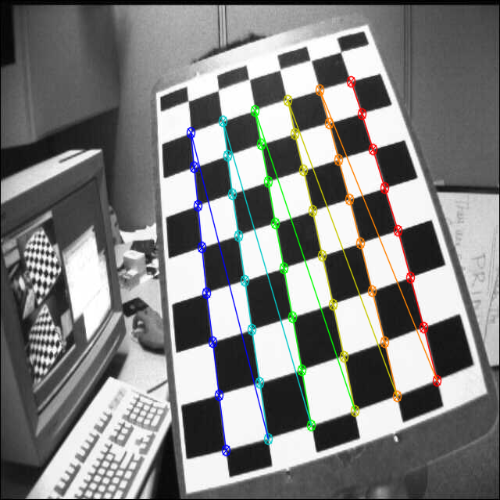

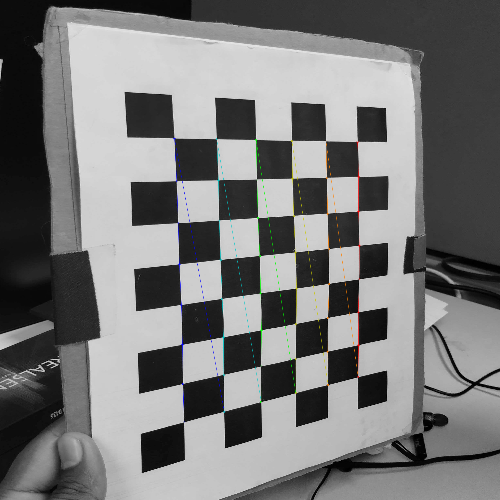

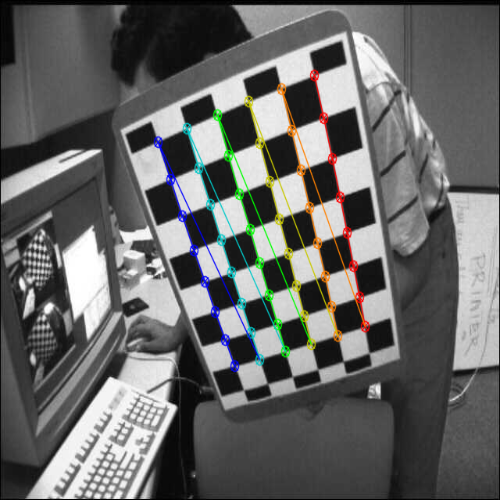

...

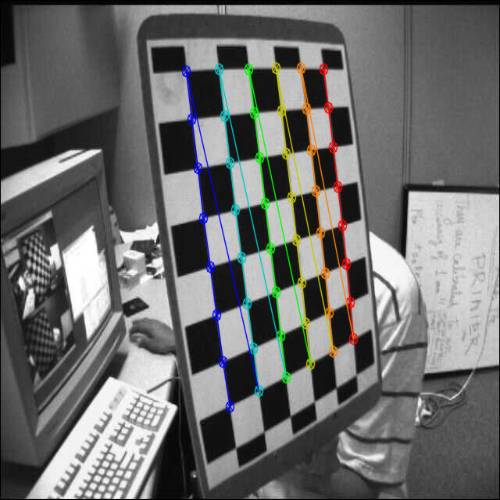

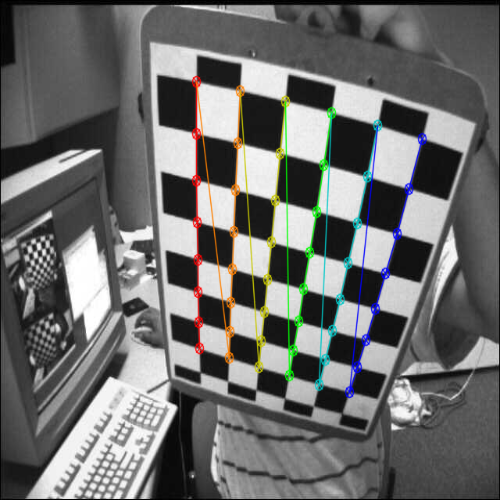

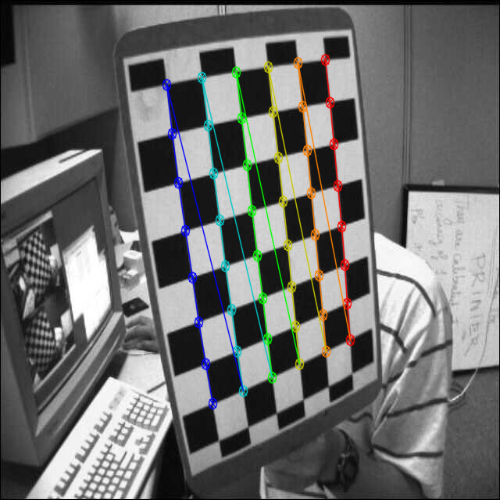

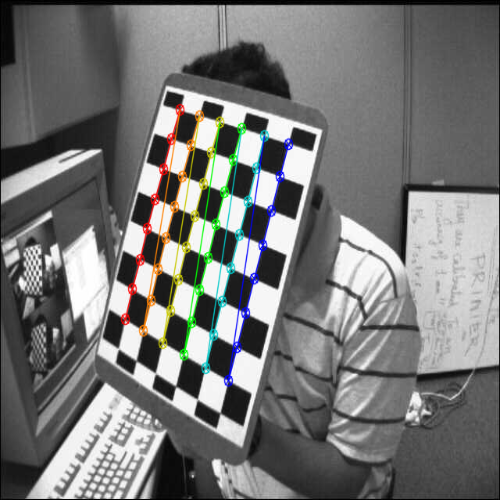

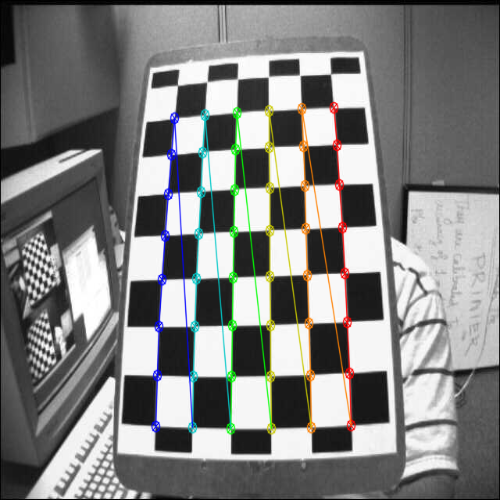

In [5]:
for fname in images:
    # read image
    # TODO Part A (1): read the image from "fname" using cv2 imread
    img = cv2.imread(fname)
    
    # TODO Part A (2): convert img to gray scale using cvtColor using cv2.COLOR_BGR2GRAY parameter
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    # TODO Part A (3): find chess board corners using cv2 findChessboardCorners function, with "gray", grid size
    ret, corners = cv2.findChessboardCorners(gray,(8,6),None)
    
    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)

        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(corners2)

        # Draw and display the corners
        # TODO Part A (6): find chess board corners using cv2 findChessboardCorners function, with "img", grid size, corners2, and ret as parameters
        img = cv2.drawChessboardCorners(img,(8,6),corners2,ret)
        img = cv2.resize (img, (500, 500))
        # TODO Part A (4): display the image using cv2_imshow
        cv2_imshow(img)
       
        

In [6]:
# TODO Part A (5): Compute camera matrix using cv2 calibrateCamera with objpoints, imgpoints, gray.shape[::-1] as parameters
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints,imgpoints,gray.shape[::-1],None,None)


In [7]:
img = cv2.imread(images[0])
h,  w = img.shape[:2]

# the new camera matrix is being computed to remove the distortion
newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))

# undistort
dst = cv2.undistort(img, mtx, dist, None, newcameramtx)

# crop the image
x,y,w,h = roi
dst = dst[y:y+h, x:x+w]

cv2.imwrite('calibresult.png',dst)

print('Camera Matrix' )
print(mtx)

print('dist')
print(dist)

print('rvecs:')
print(rvecs)

print('tvecs')
print(tvecs)

Camera Matrix
[[556.98911338   0.         371.1326332 ]
 [  0.         570.42049598 303.12687607]
 [  0.           0.           1.        ]]
dist
[[-2.32599179e-03 -2.07338556e-03  4.28201395e-02  1.89014903e-02
   8.81749542e-05]]
rvecs:
(array([[-0.17427495],
       [ 0.03738356],
       [ 0.34047092]]), array([[-0.29713112],
       [-0.07566091],
       [-1.344379  ]]), array([[-0.25358433],
       [ 0.29212764],
       [ 1.31650909]]), array([[-0.04750929],
       [-0.11003191],
       [ 1.57848102]]), array([[ 0.56288128],
       [-0.3996491 ],
       [ 1.23814041]]), array([[-0.00109491],
       [ 0.15086931],
       [ 0.00483261]]), array([[ 0.29056679],
       [-0.46580759],
       [ 0.11340475]]), array([[-0.36942279],
       [-0.58981046],
       [ 1.29178763]]), array([[ 0.55631126],
       [ 0.70645944],
       [-1.28506116]]), array([[-0.11111158],
       [-0.55243534],
       [ 1.31803134]]), array([[-0.15739201],
       [ 0.21278637],
       [-1.22026633]]), array([[-0.2

# Save all 8x6 calibrated final outputs

In [8]:
for fname in images:
  img = cv2.imread(fname)
  h,  w = img.shape[:2]

  # the new camera matrix is being computed to remove the distortion
  newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))

  # undistort
  dst = cv2.undistort(img, mtx, dist, None, newcameramtx)

  # crop the image
  x,y,w,h = roi
  dst = dst[y:y+h, x:x+w]

  fname = fname.replace('.jpg','')

  cv2.imwrite(fname+'calibresult_8x6.png',dst)




In [9]:
def draw(img, corners, imgpts):
    corner = tuple(corners[0].ravel())
    kk=tuple(imgpts[0].ravel().astype(int))
    print(tuple(imgpts[0].ravel().astype(int)))
    img = cv2.line(img, (int(corner[0]),int(corner[1])), tuple(imgpts[0].ravel().astype(int)), (255,0,0), 5)
    img = cv2.line(img, (int(corner[0]),int(corner[1])), tuple(imgpts[1].ravel().astype(int)), (0,255,0), 5)
    img = cv2.line(img, (int(corner[0]),int(corner[1])), tuple(imgpts[2].ravel().astype(int)), (0,0,255), 5)
    return img

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
objp = np.zeros((6*8,3), np.float32)
objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)
axis = np.float32([[3,0,0], [0,3,0], [0,0,-3]]).reshape(-1,3)
print ('done')


done


rvecs
[[-0.17427493]
 [ 0.03738356]
 [ 0.34047091]]
tvecs
[[-1.43246285]
 [-5.2663963 ]
 [12.56397294]]
images/left03.jpg
UNITS of DISTANCE is INCHES
dist: 13.698185859960168 inches
(433, 114)


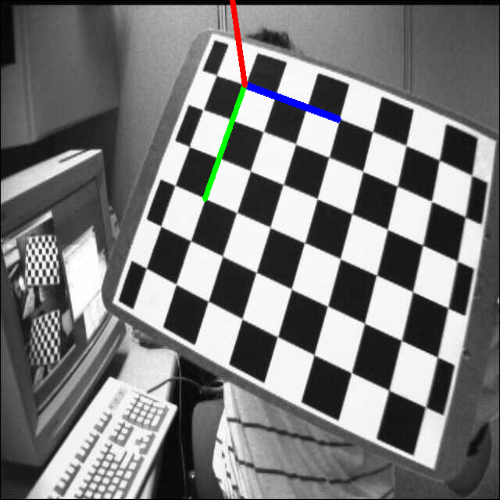

rvecs
[[-0.2971311]
 [-0.0756609]
 [-1.344379 ]]
tvecs
[[-4.19048285]
 [ 1.50522613]
 [12.21335021]]
images/left08.jpg
UNITS of DISTANCE is INCHES
dist: 12.999683672050478 inches
(223, 247)


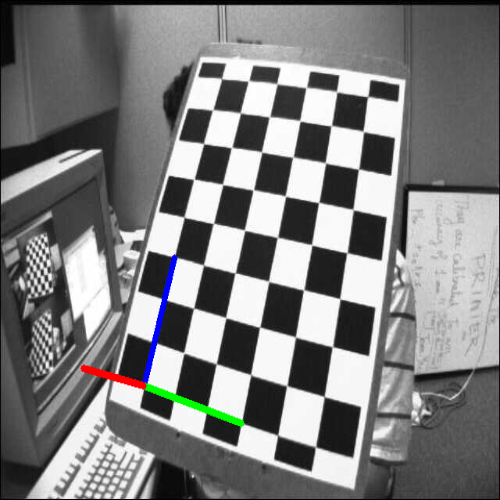

rvecs
[[-0.25358433]
 [ 0.29212764]
 [ 1.31650909]]
tvecs
[[ 1.83073012]
 [-5.26877507]
 [12.57893536]]
images/left05.jpg
UNITS of DISTANCE is INCHES
dist: 13.760130025672538 inches
(491, 181)


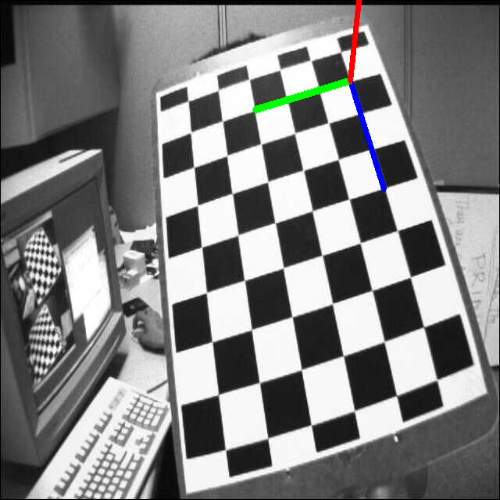

rvecs
[[-0.04750929]
 [-0.11003191]
 [ 1.57848102]]
tvecs
[[7.10368633]
 [2.31163025]
 [3.23658275]]
images/left14.jpg
UNITS of DISTANCE is INCHES
dist: 8.141342754731411 inches
(1769, 1491)


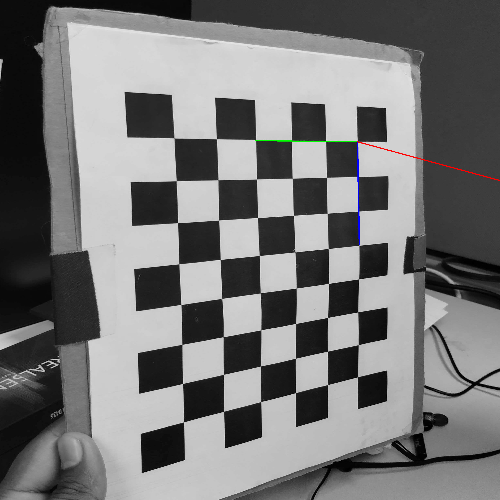

rvecs
[[ 0.56288128]
 [-0.3996491 ]
 [ 1.23814041]]
tvecs
[[ 0.68410437]
 [-5.07257918]
 [11.7660824 ]]
images/left13.jpg
UNITS of DISTANCE is INCHES
dist: 12.831202336329142 inches
(434, 188)


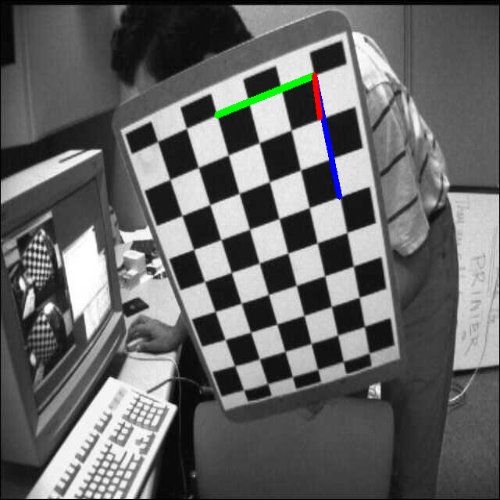

rvecs
[[-0.00109493]
 [ 0.15086932]
 [ 0.00483261]]
tvecs
[[-3.69822248]
 [-4.32438856]
 [13.06657954]]
images/left04.jpg
UNITS of DISTANCE is INCHES
dist: 14.25176083466763 inches
(341, 117)


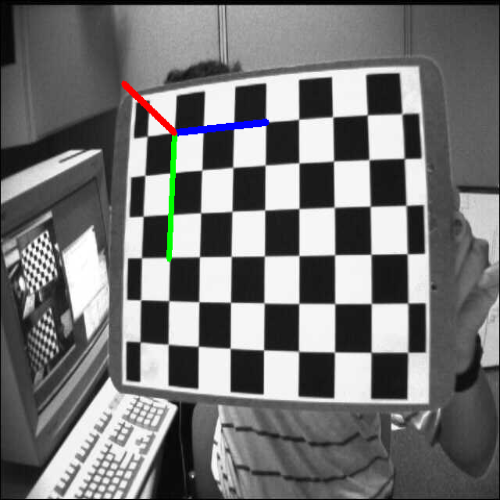

rvecs
[[ 0.29056678]
 [-0.46580759]
 [ 0.11340475]]
tvecs
[[-3.33293754]
 [-4.71311682]
 [11.41500944]]
images/left09.jpg
UNITS of DISTANCE is INCHES
dist: 12.791574702940618 inches
(344, 108)


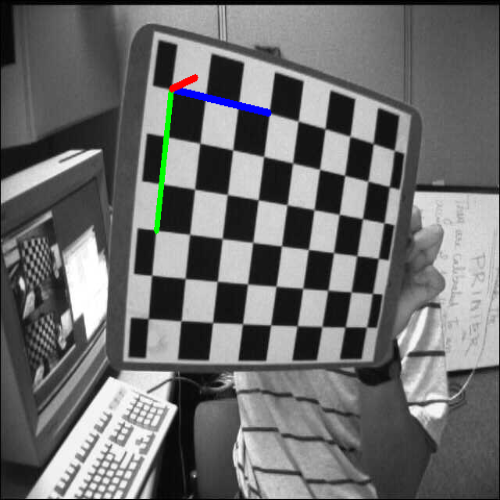

rvecs
[[-0.36942279]
 [-0.58981046]
 [ 1.29178763]]
tvecs
[[ 1.09894577]
 [-6.13103483]
 [13.81392735]]
images/left11.jpg
UNITS of DISTANCE is INCHES
dist: 15.153278810674973 inches
(431, 178)


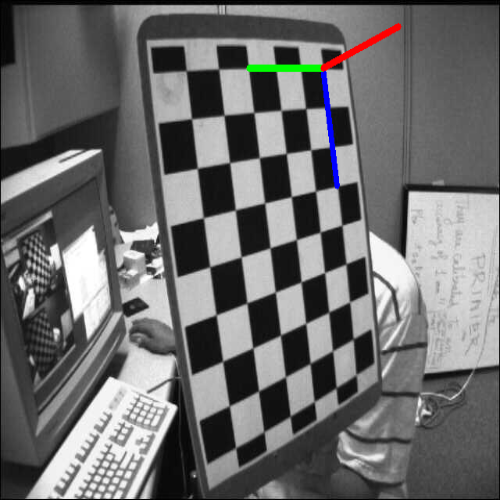

rvecs
[[ 0.55631126]
 [ 0.70645944]
 [-1.28506116]]
tvecs
[[-2.97606202]
 [ 0.79308598]
 [14.20981356]]
images/left02.jpg
UNITS of DISTANCE is INCHES
dist: 14.539763818909158 inches
(253, 248)


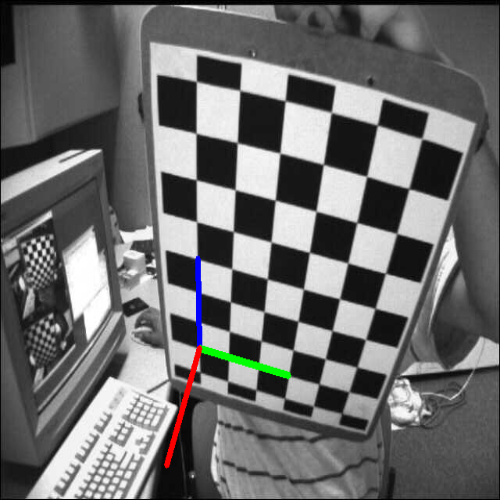

rvecs
[[-0.11111158]
 [-0.55243534]
 [ 1.31803134]]
tvecs
[[ 1.08254004]
 [-5.92322581]
 [12.83393709]]
images/left15.jpg
UNITS of DISTANCE is INCHES
dist: 14.176263196121846 inches
(431, 177)


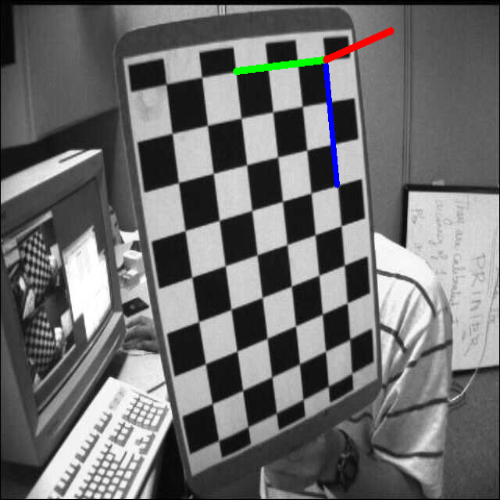

rvecs
[[-0.15739202]
 [ 0.21278638]
 [-1.22026632]]
tvecs
[[-6.96442859]
 [ 0.07624713]
 [17.83527   ]]
images/left07.jpg
UNITS of DISTANCE is INCHES
dist: 19.146956293593238 inches
(188, 219)


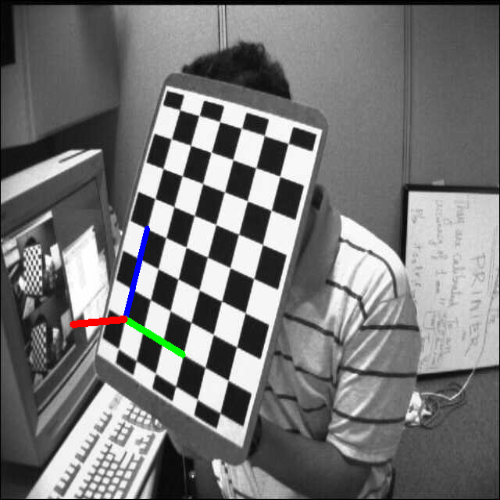

rvecs
[[-0.21535652]
 [ 0.20414248]
 [ 1.53670433]]
tvecs
[[ 1.34222257]
 [-4.74100181]
 [12.94934175]]
images/left12.jpg
UNITS of DISTANCE is INCHES
dist: 13.855111377559435 inches
(435, 218)


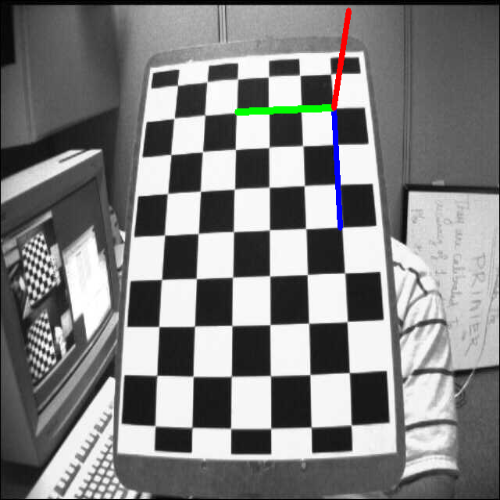

In [10]:
for fname in images:
    # read image
    # TODO Part A (1): read the image from "fname" using cv2 imread
    img = cv2.imread(fname)
   
    # TODO Part A (2): convert img to gray scale using cvtColor using cv2.COLOR_BGR2GRAY parameter
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    # TODO Part A (3): find chess board corners using cv2 findChessboardCorners function, with "gray", grid size
    ret, corners = cv2.findChessboardCorners(gray,(8,6),None)

    if ret == True:
        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        
        # Find the rotation and translation vectors.
        # TODO Part A (7): Find rotation and translation matrix by calling cv2.solvePnP using objp, corners2, mtx and dist as parameters
        ret,rvecs, tvecs = cv2.solvePnP(objp,corners2,mtx,dist)
        print('rvecs')
        print(rvecs)

        print('tvecs')
        print(tvecs)
        
        # TODO Part B: Print the distance from the camera using np linalg norm function with tvecs as input and mention the unit of measurement in pdf
        print(fname)
        print('UNITS of DISTANCE is INCHES')
        print('dist: ' + str(np.linalg.norm(tvecs, ord=None, axis=None, keepdims=False))+' inches')
        # project 3D points to image plane
        imgpts, jac = cv2.projectPoints(axis, rvecs, tvecs, mtx, dist)
        img = draw(img,corners2,imgpts)
        img = cv2.resize (img, (500, 500))
        # TODO Part A (4): display the image using cv2_imshow

        cv2_imshow(img)
        fname = fname.replace('.jpg','')
        cv2.imwwrite(fname+'orientation_8x6.png',img)


#Section 2 (using 7x6 for better result)
* 7x6 pattern (as given in OPENCV2 tutorial)
https://docs.opencv.org/4.x/dc/dbb/tutorial_py_calibration.html

* Using 7x6 gives less distortion. I am adding this section here as reference. To provide visual proof as to why I decided to go with 7x6 instead of 8x6 for my final result reporting in Part-A and Part-B of the assigment.

In [11]:

# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*7,3), np.float32)
objp[:,:2] = np.mgrid[0:7,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the left_images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

# TODO Part A (1): load the list of images in images using glob or any other function.
path = 'images/*.jpg'
images = glob.glob(path)
print(images)


['images/left03.jpg', 'images/left08.jpg', 'images/left05.jpg', 'images/left06.jpg', 'images/left14.jpg', 'images/left13.jpg', 'images/left04.jpg', 'images/left09.jpg', 'images/left01.jpg', 'images/left11.jpg', 'images/left02.jpg', 'images/left15.jpg', 'images/left07.jpg', 'images/left12.jpg']


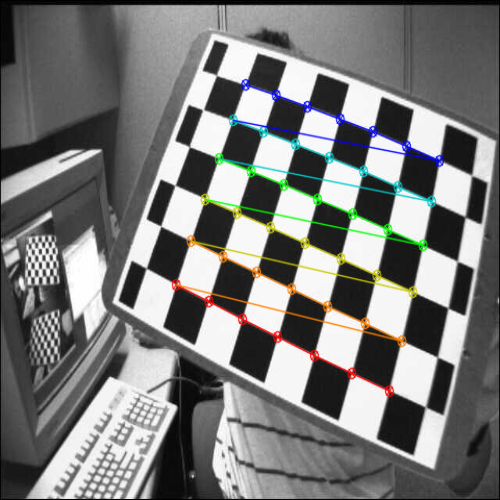

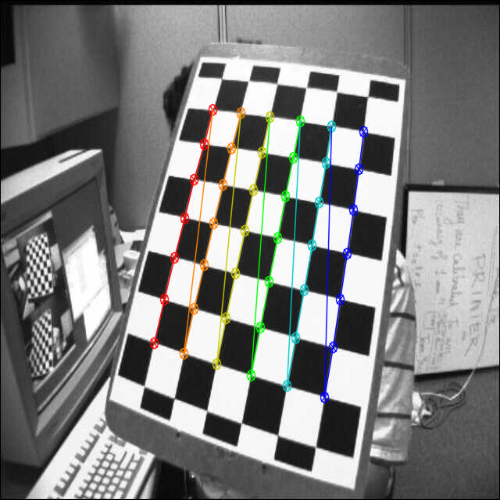

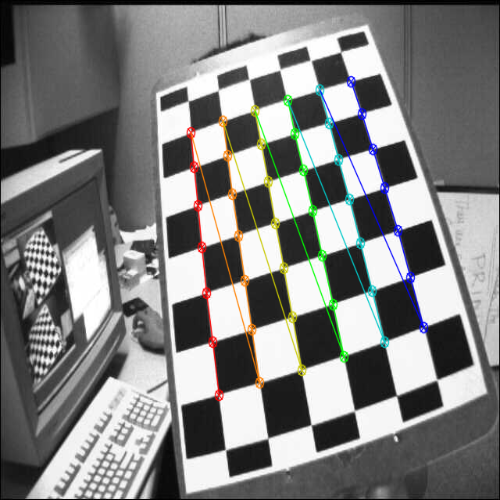

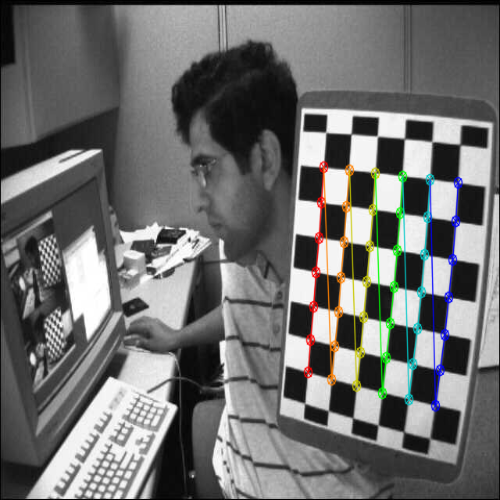

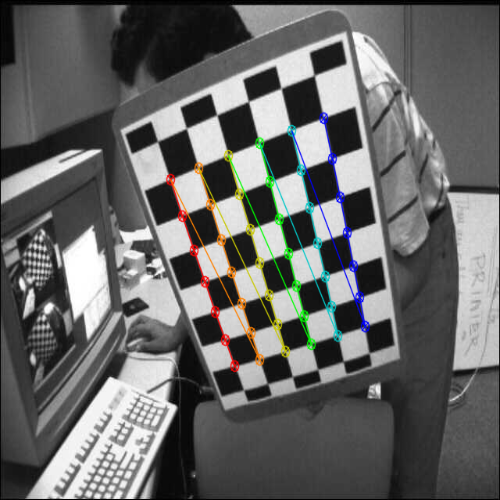

...

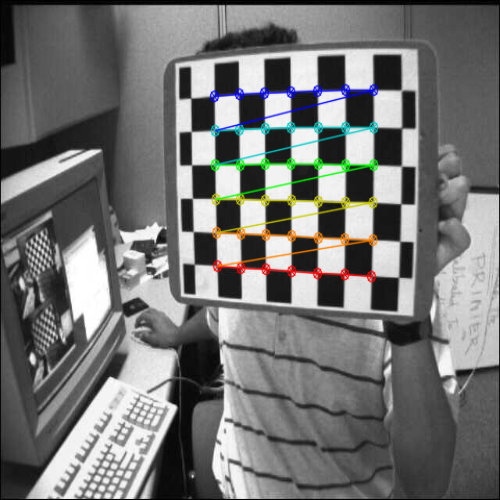

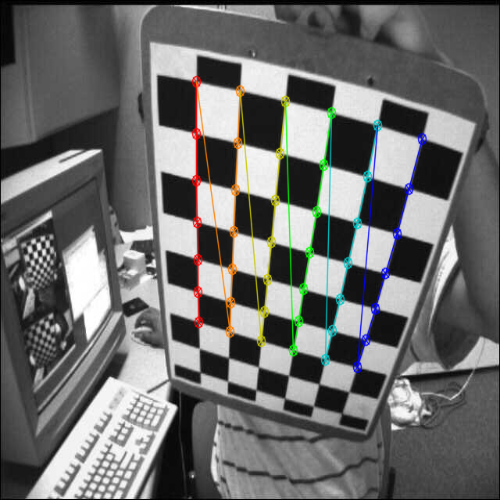

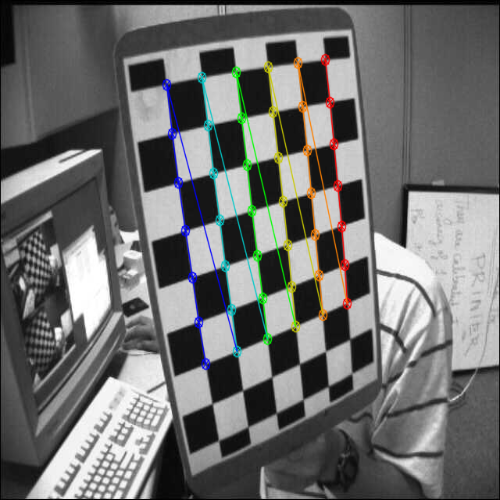

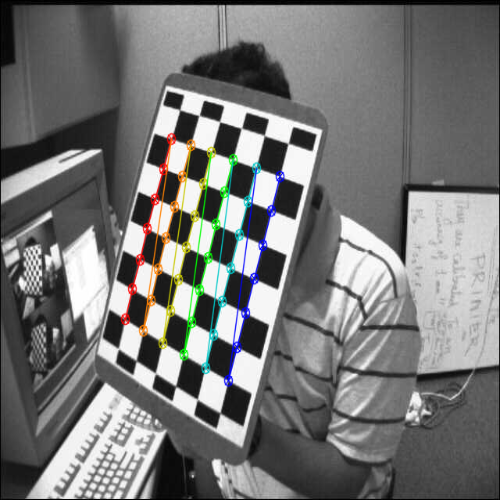

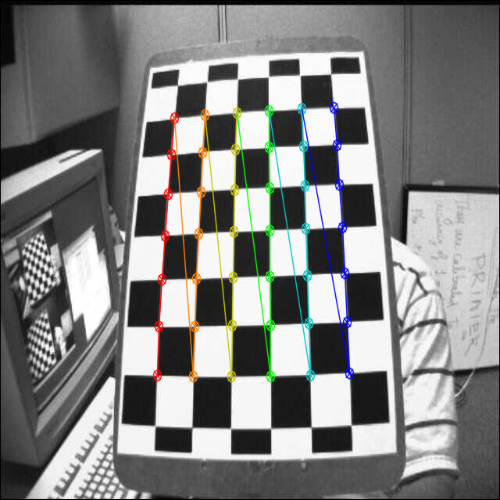

In [12]:
for fname in images:
    # read image
    # TODO Part A (1): read the image from "fname" using cv2 imread
    img = cv2.imread(fname)
    
    # TODO Part A (2): convert img to gray scale using cvtColor using cv2.COLOR_BGR2GRAY parameter
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    # TODO Part A (3): find chess board corners using cv2 findChessboardCorners function, with "gray", grid size
    ret, corners = cv2.findChessboardCorners(gray,(7,6),None)
    
    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)

        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(corners2)

        # Draw and display the corners
        # TODO Part A (6): find chess board corners using cv2 findChessboardCorners function, with "img", grid size, corners2, and ret as parameters
        img = cv2.drawChessboardCorners(img,(7,6),corners2,ret)
        img = cv2.resize (img, (500, 500))
        # TODO Part A (4): display the image using cv2_imshow
        cv2_imshow(img)
       
        

In [13]:
# TODO Part A (5): Compute camera matrix using cv2 calibrateCamera with objpoints, imgpoints, gray.shape[::-1] as parameters
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints,imgpoints,gray.shape[::-1],None,None)


In [14]:
img = cv2.imread(images[0])
h,  w = img.shape[:2]

# the new camera matrix is being computed to remove the distortion
newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))

# undistort
dst = cv2.undistort(img, mtx, dist, None, newcameramtx)

# crop the image
x,y,w,h = roi
dst = dst[y:y+h, x:x+w]
cv2.imwrite('calibresult.png',dst)

print('Camera Matrix' )
print(mtx)

print('dist')
print(dist)

print('rvecs:')
print(rvecs)

print('tvecs')
print(tvecs)

Camera Matrix
[[534.07088364   0.         341.53407554]
 [  0.         534.11914595 232.94565259]
 [  0.           0.           1.        ]]
dist
[[-2.92971637e-01  1.07706962e-01  1.31038376e-03 -3.11018780e-05
   4.34798110e-02]]
rvecs:
(array([[-0.2645143 ],
       [-0.39360849],
       [-2.74787379]]), array([[-0.45883216],
       [-0.08848877],
       [-1.33510786]]), array([[-0.45993978],
       [-0.3142018 ],
       [-1.76122223]]), array([[-0.29979221],
       [ 0.39216377],
       [-1.4348239 ]]), array([[ 0.30697385],
       [ 0.5038552 ],
       [-1.82824733]]), array([[-0.37843358],
       [-0.18064237],
       [-3.11615996]]), array([[-0.43239599],
       [ 0.25603401],
       [-3.08832021]]), array([[ 0.41531697],
       [ 0.65664497],
       [-1.3373494 ]]), array([[-0.17288944],
       [-0.46764681],
       [ 1.34745198]]), array([[-0.32034625],
       [ 0.1597993 ],
       [-1.24149595]]), array([[-0.35367631],
       [-0.24363035],
       [-1.56874295]]))
tvecs
(array

# Save all 7x6 calibrated final outputs

In [15]:
for fname in images:
  img = cv2.imread(fname)
  h,  w = img.shape[:2]

  # the new camera matrix is being computed to remove the distortion
  newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))

  # undistort
  dst = cv2.undistort(img, mtx, dist, None, newcameramtx)

  # crop the image
  x,y,w,h = roi
  dst = dst[y:y+h, x:x+w]
  fname = fname.replace('.jpg','')
  cv2.imwrite(fname+'calibresult_7x6.png',dst)




In [16]:
def draw(img, corners, imgpts):
    corner = tuple(corners[0].ravel())
    kk=tuple(imgpts[0].ravel().astype(int))
    print(tuple(imgpts[0].ravel().astype(int)))
    img = cv2.line(img, (int(corner[0]),int(corner[1])), tuple(imgpts[0].ravel().astype(int)), (255,0,0), 5)
    img = cv2.line(img, (int(corner[0]),int(corner[1])), tuple(imgpts[1].ravel().astype(int)), (0,255,0), 5)
    img = cv2.line(img, (int(corner[0]),int(corner[1])), tuple(imgpts[2].ravel().astype(int)), (0,0,255), 5)
    return img

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
objp = np.zeros((6*8,3), np.float32)
objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)
axis = np.float32([[3,0,0], [0,3,0], [0,0,-3]]).reshape(-1,3)
print ('done')


done


rvecs
[[-0.28043914]
 [ 0.18761788]
 [ 0.35501034]]
tvecs
[[-0.65471592]
 [-3.6414316 ]
 [12.46240735]]
images/left03.jpg
UNITS of DISTANCE is INCHES
dist: 13.00001053859455 inches
(434, 113)


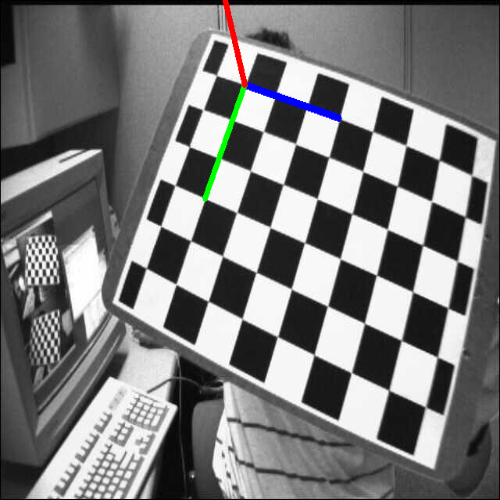

rvecs
[[-0.45693721]
 [-0.08827695]
 [-1.33578113]]
tvecs
[[-3.52092973]
 [ 3.07592765]
 [11.41695006]]
images/left08.jpg
UNITS of DISTANCE is INCHES
dist: 12.3371400954914 inches
(222, 246)


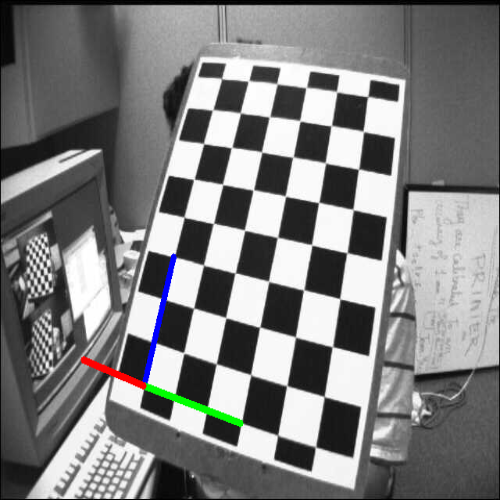

rvecs
[[-0.29519871]
 [ 0.43214082]
 [ 1.31242384]]
tvecs
[[ 2.55204595]
 [-3.68653804]
 [12.19299663]]
images/left05.jpg
UNITS of DISTANCE is INCHES
dist: 12.991253522092153 inches
(492, 180)


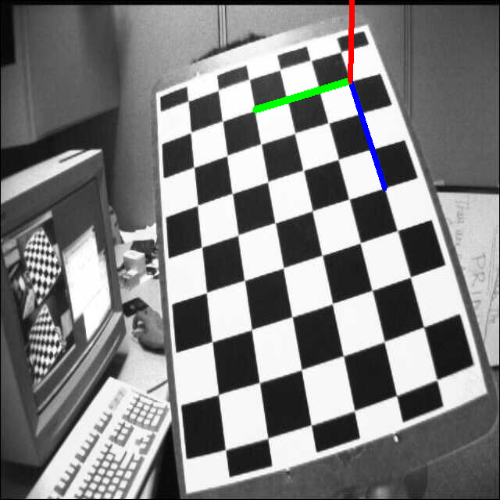

rvecs
[[ 0.0458954 ]
 [-0.43714949]
 [ 1.55342485]]
tvecs
[[8.90646871]
 [5.45339999]
 [6.19666765]]
images/left14.jpg
UNITS of DISTANCE is INCHES
dist: 12.143452813594683 inches
(1746, 1565)


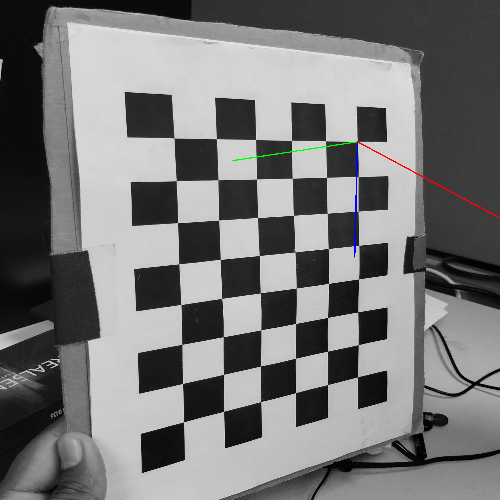

rvecs
[[ 0.4641273 ]
 [-0.28209944]
 [ 1.23865381]]
tvecs
[[ 1.36539227]
 [-3.59788293]
 [11.5933261 ]]
images/left13.jpg
UNITS of DISTANCE is INCHES
dist: 12.215329210250303 inches
(435, 188)


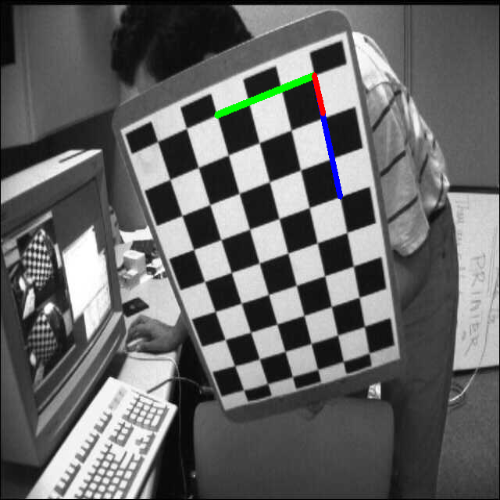

rvecs
[[-0.11507265]
 [ 0.24070518]
 [-0.00252724]]
tvecs
[[-2.94711731]
 [-2.6446696 ]
 [12.95815543]]
images/left04.jpg
UNITS of DISTANCE is INCHES
dist: 13.549670470509588 inches
(340, 117)


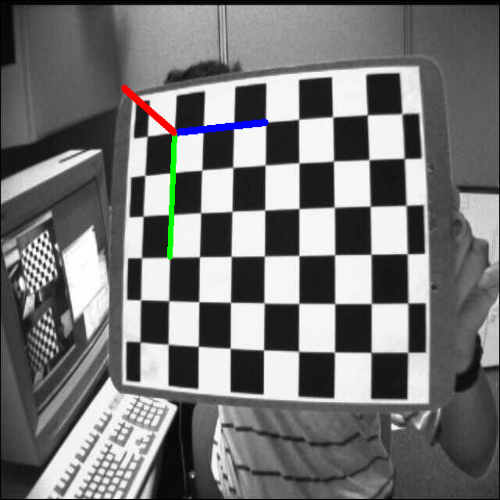

rvecs
[[ 0.19851664]
 [-0.42407882]
 [ 0.13326293]]
tvecs
[[-2.63533766]
 [-3.18411854]
 [11.08553844]]
images/left09.jpg
UNITS of DISTANCE is INCHES
dist: 11.831009166443112 inches
(344, 108)


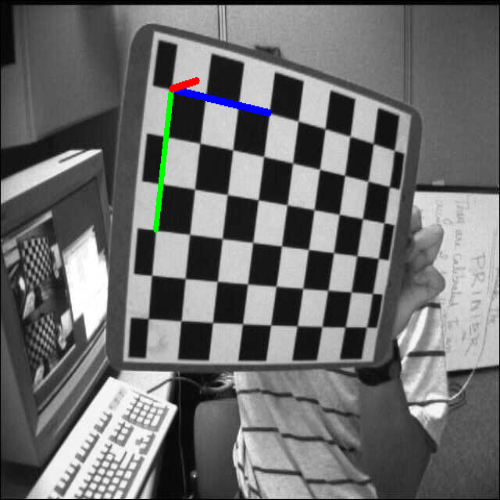

rvecs
[[-0.422231  ]
 [-0.49484794]
 [ 1.33740773]]
tvecs
[[ 1.89562132]
 [-4.37283239]
 [13.48379584]]
images/left11.jpg
UNITS of DISTANCE is INCHES
dist: 14.301321391895794 inches
(432, 178)


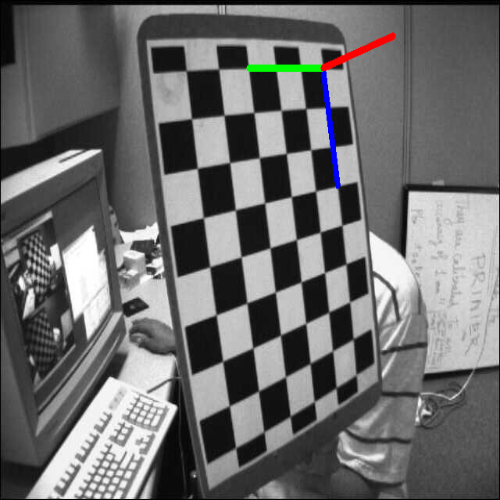

rvecs
[[ 0.41477399]
 [ 0.65586843]
 [-1.337408  ]]
tvecs
[[-2.21978229]
 [ 2.60105216]
 [13.46205167]]
images/left02.jpg
UNITS of DISTANCE is INCHES
dist: 13.88955510571647 inches
(252, 248)


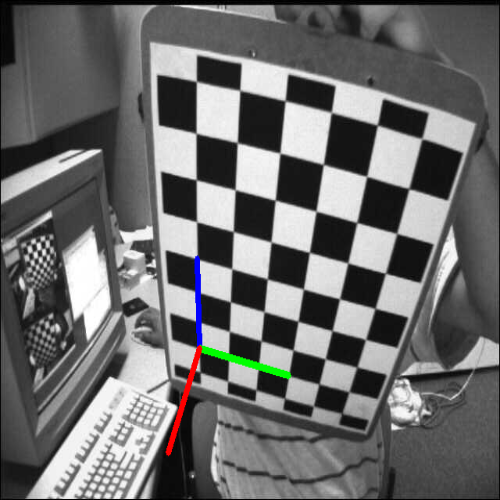

rvecs
[[-0.17341976]
 [-0.46662773]
 [ 1.34744823]]
tvecs
[[ 1.8183409]
 [-4.2646081]
 [12.4593716]]
images/left15.jpg
UNITS of DISTANCE is INCHES
dist: 13.293953001283137 inches
(432, 177)


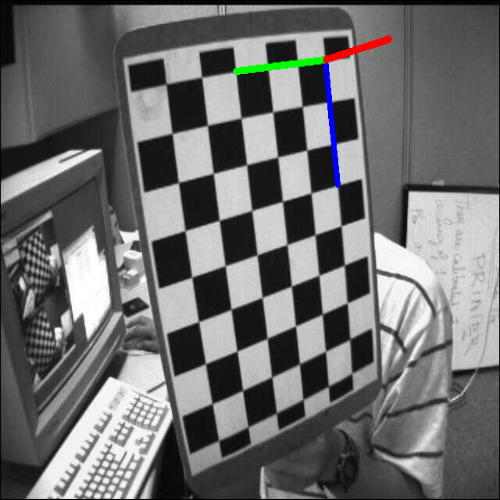

rvecs
[[-0.3220191 ]
 [ 0.16092536]
 [-1.24120313]]
tvecs
[[-5.93964637]
 [ 2.39547402]
 [16.77173332]]
images/left07.jpg
UNITS of DISTANCE is INCHES
dist: 17.952958904125545 inches
(188, 219)


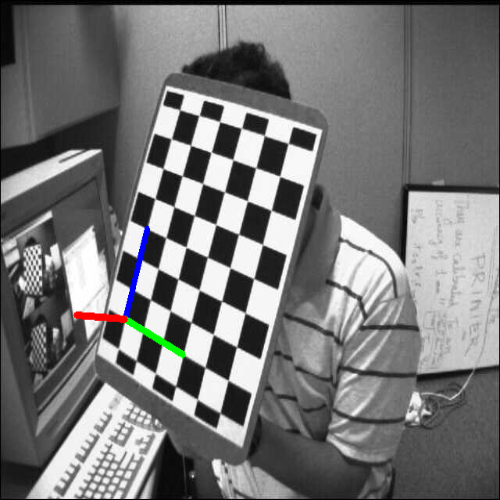

rvecs
[[-0.24205965]
 [ 0.35118903]
 [ 1.53026421]]
tvecs
[[ 2.05247068]
 [-3.11167241]
 [12.48284696]]
images/left12.jpg
UNITS of DISTANCE is INCHES
dist: 13.027532742970447 inches
(437, 217)


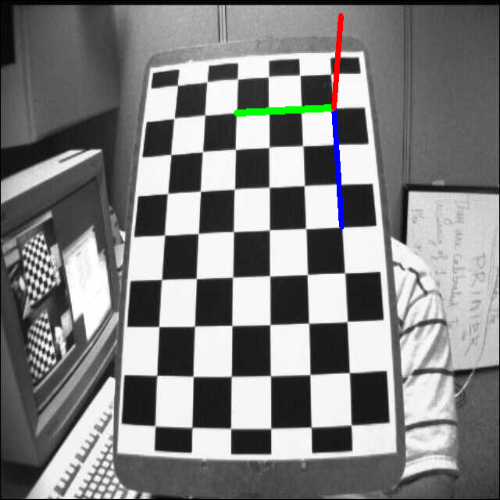

In [17]:
for fname in images:
    # read image
    # TODO Part A (1): read the image from "fname" using cv2 imread
    img = cv2.imread(fname)
   
    # TODO Part A (2): convert img to gray scale using cvtColor using cv2.COLOR_BGR2GRAY parameter
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    # TODO Part A (3): find chess board corners using cv2 findChessboardCorners function, with "gray", grid size
    ret, corners = cv2.findChessboardCorners(gray,(8,6),None)

    if ret == True:
        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        
        # Find the rotation and translation vectors.
        # TODO Part A (7): Find rotation and translation matrix by calling cv2.solvePnP using objp, corners2, mtx and dist as parameters
        ret,rvecs, tvecs = cv2.solvePnP(objp,corners2,mtx,dist)
        print('rvecs')
        print(rvecs)

        print('tvecs')
        print(tvecs)
        
        # TODO Part B: Print the distance from the camera using np linalg norm function with tvecs as input and mention the unit of measurement in pdf
        print(fname)
        print('UNITS of DISTANCE is INCHES')
        print('dist: ' + str(np.linalg.norm(tvecs, ord=None, axis=None, keepdims=False))+' inches')
        # project 3D points to image plane
        imgpts, jac = cv2.projectPoints(axis, rvecs, tvecs, mtx, dist)
        img = draw(img,corners2,imgpts)
        img = cv2.resize (img, (500, 500))
        # TODO Part A (4): display the image using cv2_imshow

        cv2_imshow(img)
        fname = fname.replace('.jpg','')
        cv2.imwwrite(fname+'orientation_7x6.png',img)

#Section 3:  Distortion comparison between 8x6 and 7x6. Proving 7x6 is superior
**Note to Grader:**
This is visual proof why I decided to go with 7x6 for the final result reporting

*   7x6 has better distortion correction 
*   This is why I went with 7x6 instead of 8x6



<ipython-input-18-dc0f92cda8fa>:15: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:20: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


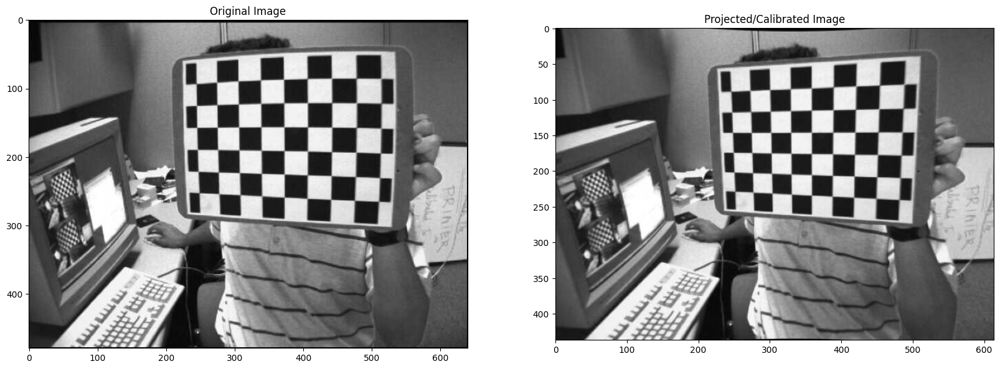

<ipython-input-18-dc0f92cda8fa>:27: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:32: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


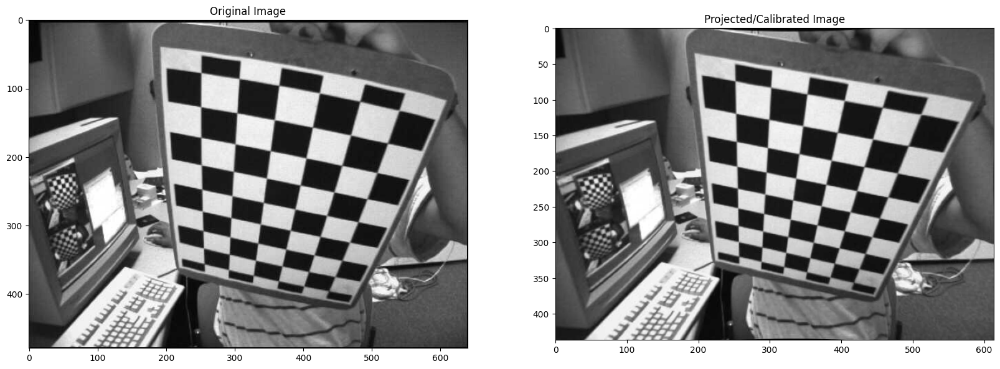

<ipython-input-18-dc0f92cda8fa>:39: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:44: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


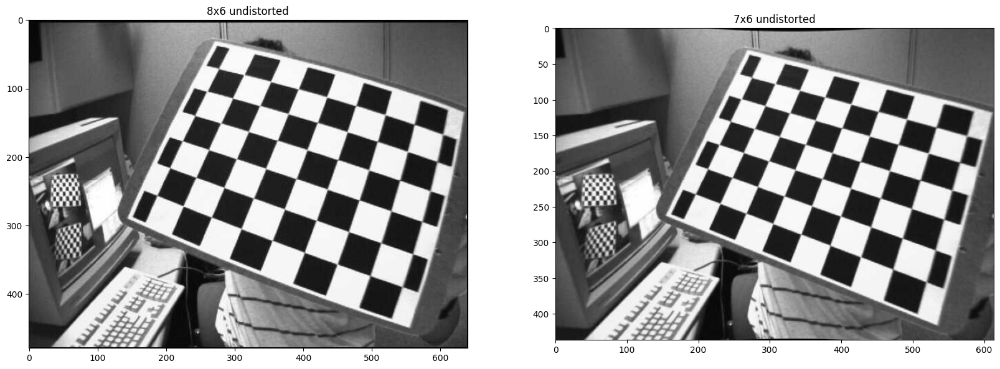

<ipython-input-18-dc0f92cda8fa>:52: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:57: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


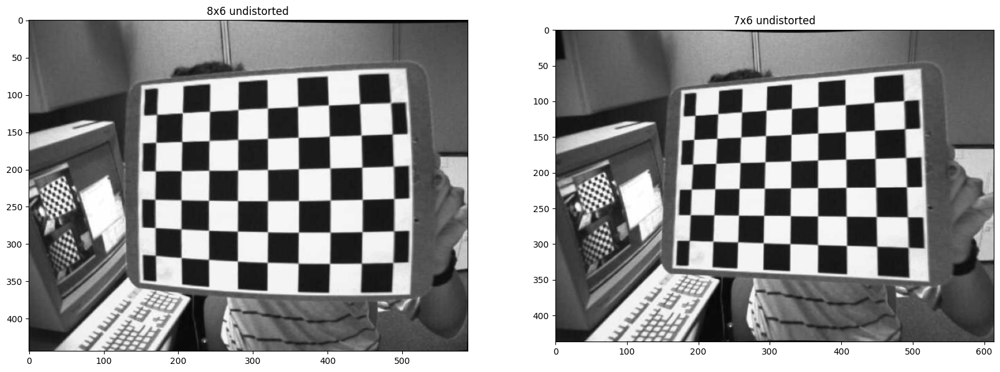

<ipython-input-18-dc0f92cda8fa>:64: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:69: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


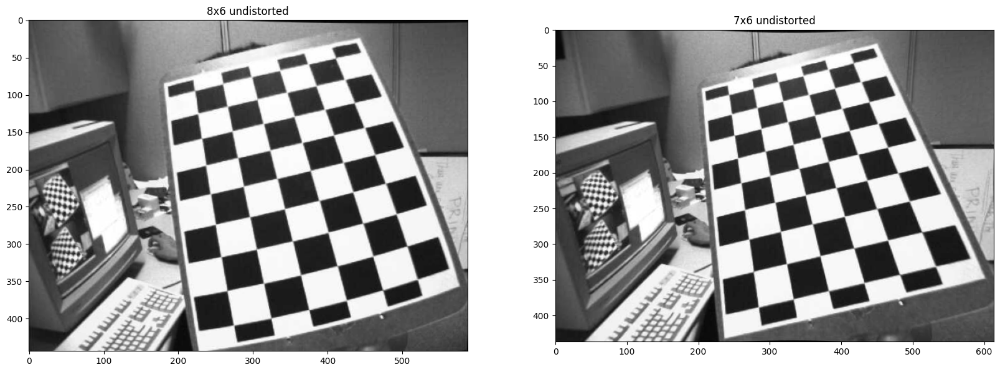

<ipython-input-18-dc0f92cda8fa>:76: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:81: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


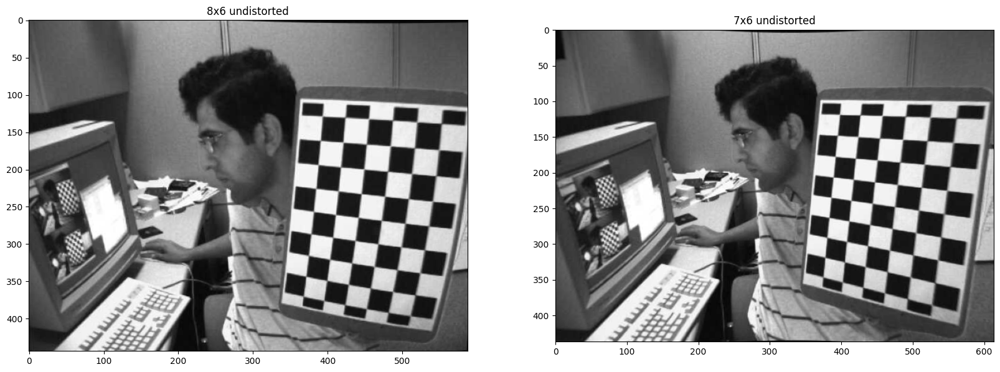

<ipython-input-18-dc0f92cda8fa>:88: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:93: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


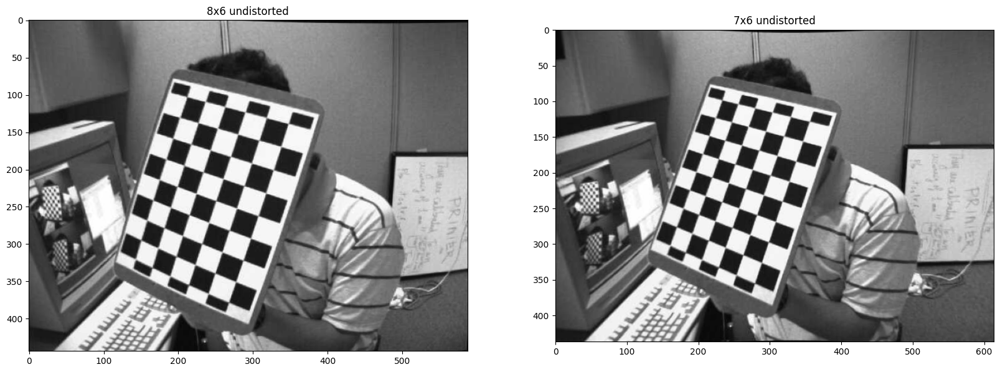

<ipython-input-18-dc0f92cda8fa>:100: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:105: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


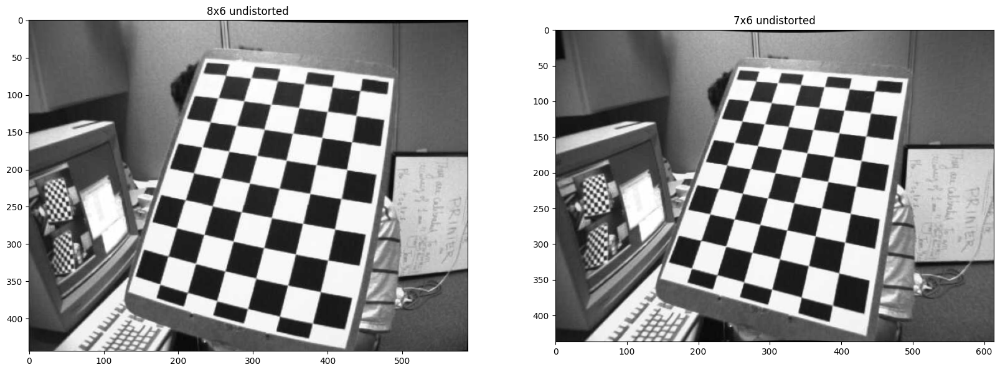

<ipython-input-18-dc0f92cda8fa>:112: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:117: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


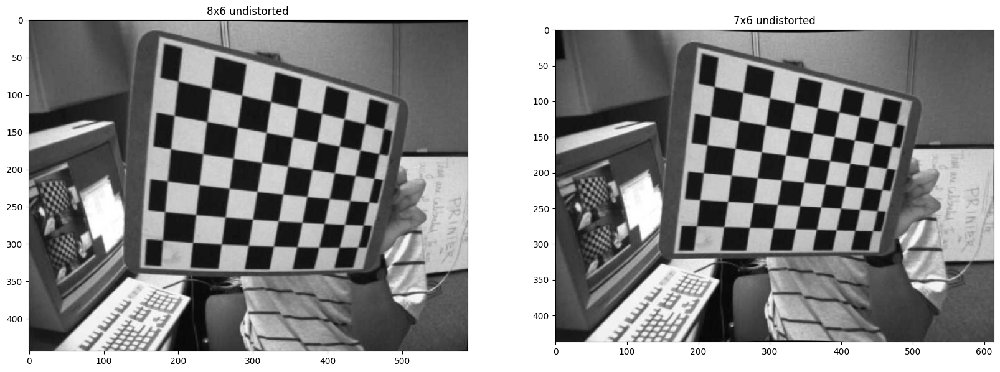

<ipython-input-18-dc0f92cda8fa>:124: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:129: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


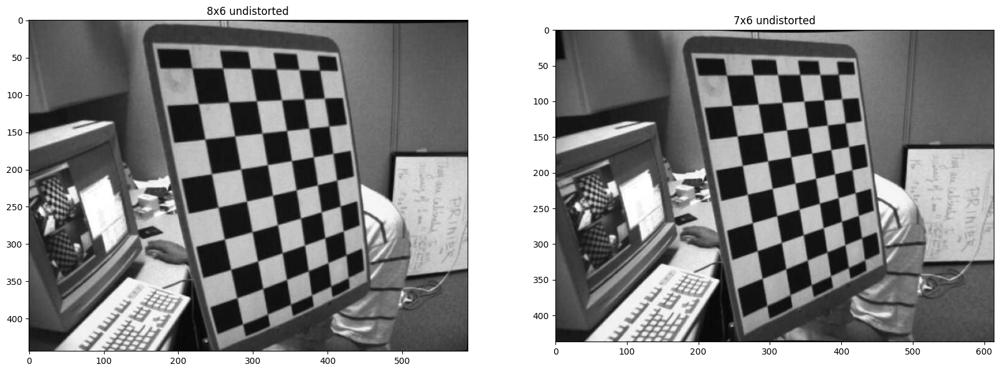

<ipython-input-18-dc0f92cda8fa>:136: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:141: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


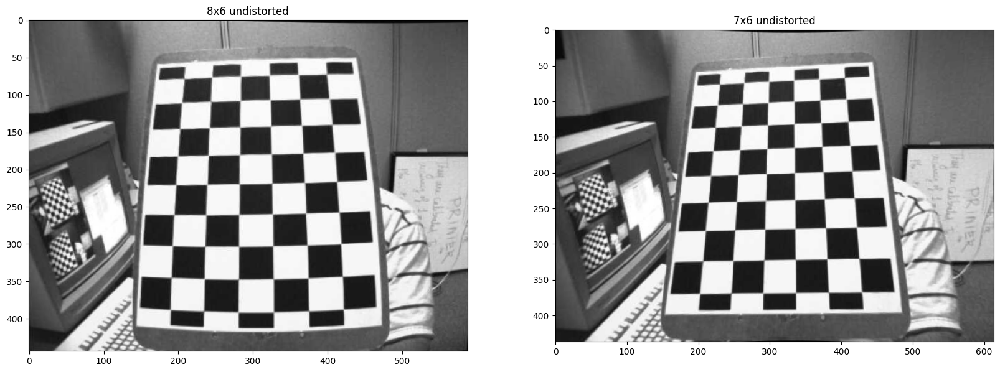

<ipython-input-18-dc0f92cda8fa>:148: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:153: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


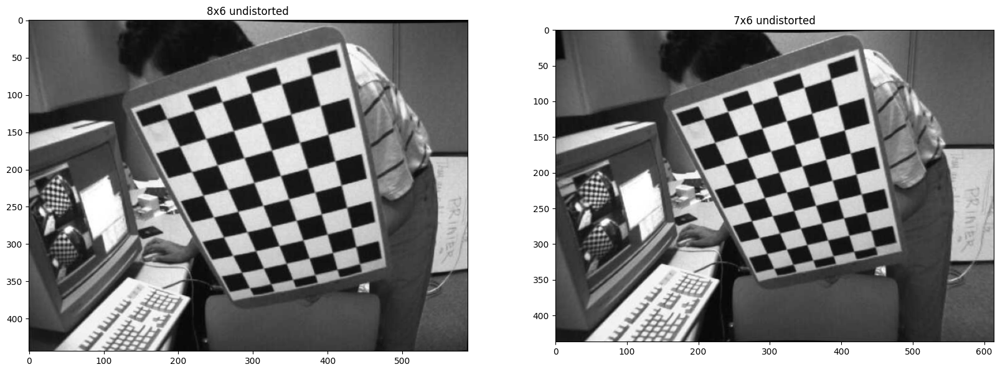

<ipython-input-18-dc0f92cda8fa>:160: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:165: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


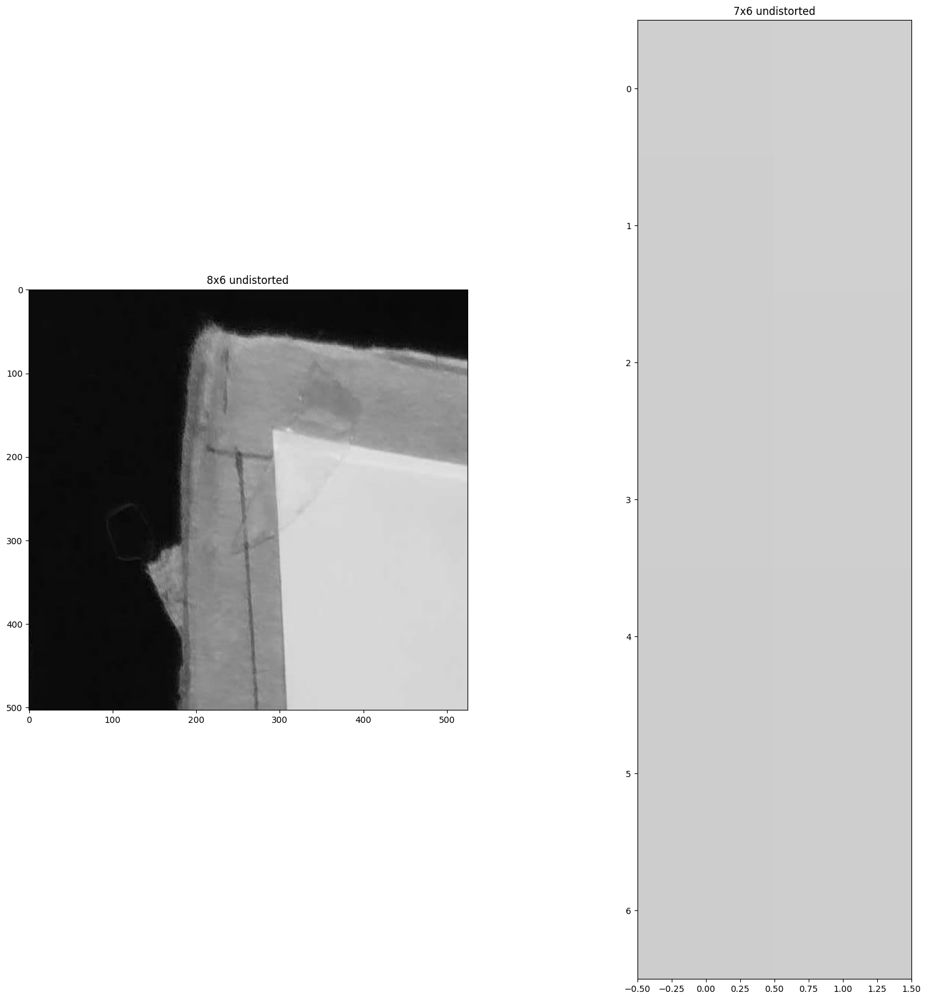

<ipython-input-18-dc0f92cda8fa>:172: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,1)
<ipython-input-18-dc0f92cda8fa>:177: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,2,2)


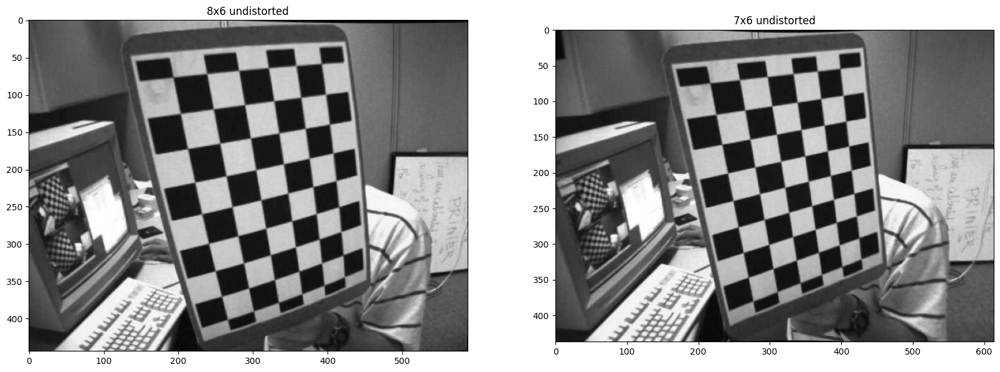

In [18]:
#img1 = cv2.imread('images/left01calibresult_7x6.png')

# TODO Part A (2): convert img to gray scale using cvtColor using cv2.COLOR_BGR2GRAY parameter
#img_reverse1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
#cv2_imshow(img_reverse1)

#img2 = cv2.imread('images/left01calibresult_8x6.png')
# TODO Part A (2): convert img to gray scale using cvtColor using cv2.COLOR_BGR2GRAY parameter
#img_reverse2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
#cv2_imshow(img_reverse2)

fig, ax = plt.subplots(2, 2, figsize=(20,20))

img_input_2 = Image.open ('images/left01.jpg').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('Original Image')

img_input_1 = Image.open ('images/left01calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('Projected/Calibrated Image')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left02.jpg').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('Original Image')

img_input_1 = Image.open ('images/left02calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('Projected/Calibrated Image')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left03.jpg').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left03calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()


fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left04calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left04calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left05calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left05calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left06calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left06calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left07calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left07calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left08calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left08calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left09calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left09calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left11calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left11calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left12calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left12calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left13calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left13calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left14calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left14calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()

fig, ax = plt.subplots(2, 2, figsize=(20,20))
img_input_2 = Image.open ('images/left15calibresult_8x6.png').convert ('RGB')
plt.subplot(1,2,1)
plt.imshow(img_input_2)
plt.title('8x6 undistorted')

img_input_1 = Image.open ('images/left15calibresult_7x6.png').convert ('RGB')
plt.subplot(1,2,2)
plt.imshow(img_input_1)
plt.title('7x6 undistorted')
plt.show()









*   From visual inspection it can be seen 7x6 patterns lead to better/less distorted images
*   Hence for final reporting I will be using 7x6 for original image vs calibrated(projected images)



#Final Result: Original Image vs Projected (Calibrated) Image

# BONUS SECTION: User Images : Whitchurch Muthumani: ASU ID: 1201000727

# Download User Images

In [ ]:
!mkdir whitchurchimages

#Start loading all the images into the folder from my personal githum repo
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_1.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_2.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_3.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_4.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_5.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_6.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_7.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_8.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_9.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_10.jpg -P sample_data/images/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_11.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_12.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_13.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_14.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_15.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_16.jpg -P whitchurchimages/
!wget https:// raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_17.jpg -P whitchurchimages/


https://: Invalid host name.
URL transformed to HTTPS due to an HSTS policy
--2023-04-21 02:42:29--  https://raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whitchurch_1.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 157618 (154K) [image/jpeg]
Saving to: ‘whitchurchimages/Whitchurch_1.jpg’

Whitchurch_1.jpg    100%[===================>] 153.92K  --.-KB/s    in 0.003s  

2023-04-21 02:42:29 (54.7 MB/s) - ‘whitchurchimages/Whitchurch_1.jpg’ saved [157618/157618]

FINISHED --2023-04-21 02:42:29--
Total wall clock time: 0.09s
Downloaded: 1 files, 154K in 0.003s (54.7 MB/s)
https://: Invalid host name.
URL transformed to HTTPS due to an HSTS policy
--2023-04-21 02:42:29--  https://raw.githubusercontent.com/Whitchurch/checkerboardimages/main/Whit

# Read Paths

In [ ]:
# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*8,3), np.float32)
objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the left_images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

# TODO Part A (1): load the list of images in images using glob or any other function.
path = 'whitchurchimages/*.jpg'
images_1 = glob.glob(path)
print(images_1)


['whitchurchimages/Whitchurch_12.jpg', 'whitchurchimages/Whitchurch_9.jpg', 'whitchurchimages/Whitchurch_8.jpg', 'whitchurchimages/Whitchurch_7.jpg', 'whitchurchimages/Whitchurch_6.jpg', 'whitchurchimages/Whitchurch_4.jpg', 'whitchurchimages/Whitchurch_5.jpg', 'whitchurchimages/Whitchurch_3.jpg', 'whitchurchimages/Whitchurch_1.jpg', 'whitchurchimages/Whitchurch_15.jpg', 'whitchurchimages/Whitchurch_13.jpg', 'whitchurchimages/Whitchurch_14.jpg', 'whitchurchimages/Whitchurch_2.jpg', 'whitchurchimages/Whitchurch_16.jpg', 'whitchurchimages/Whitchurch_17.jpg', 'whitchurchimages/Whitchurch_11.jpg']


# Draw image with known corners

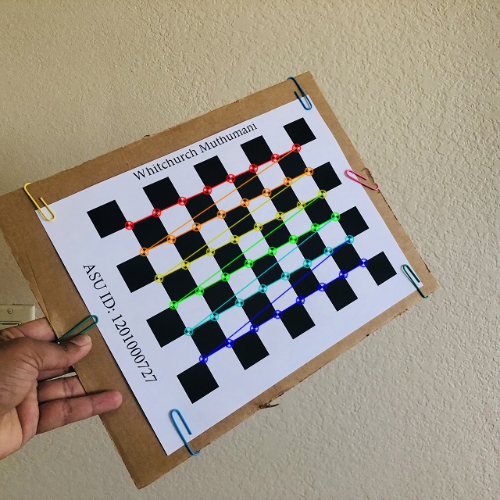

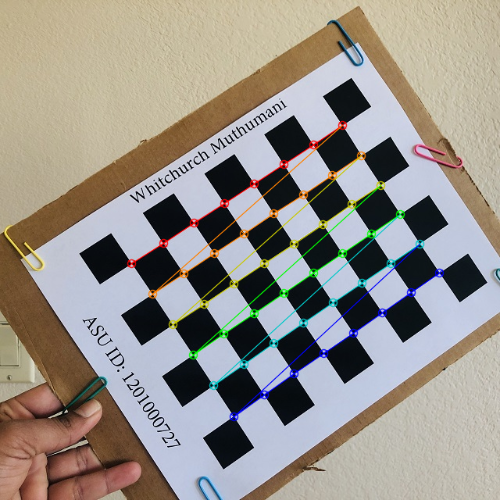

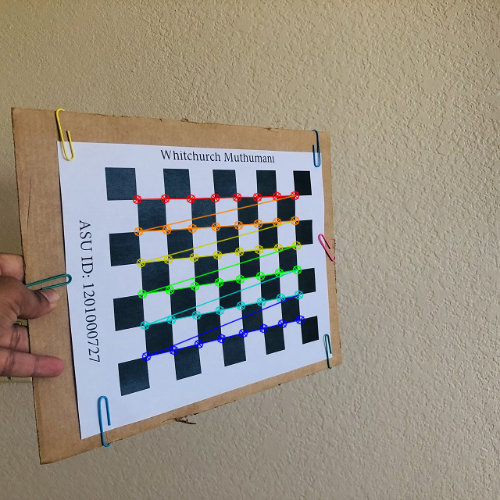

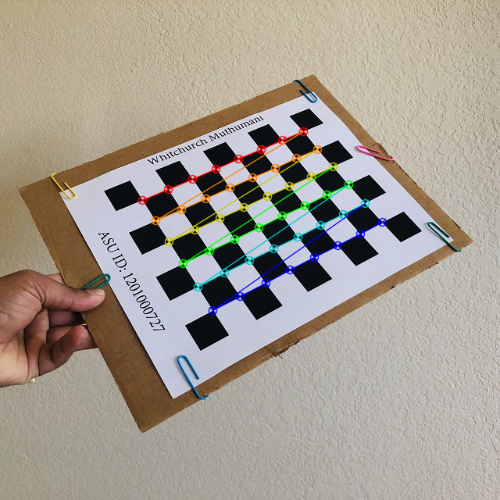

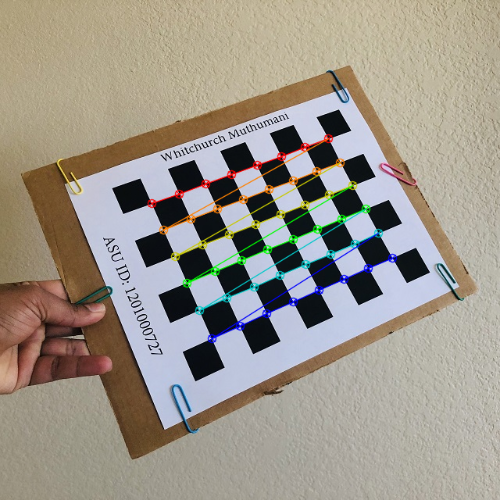

...

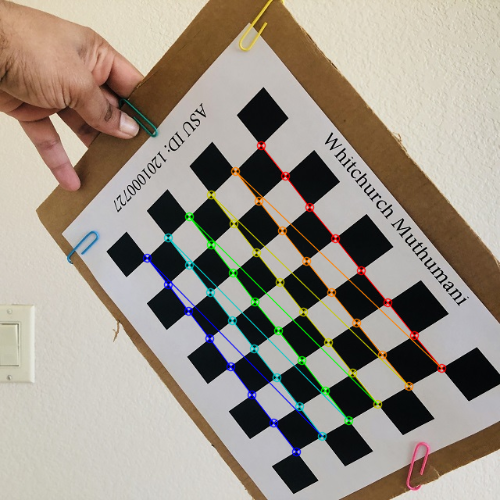

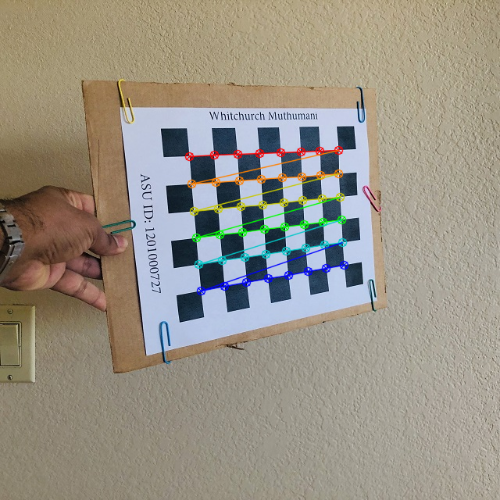

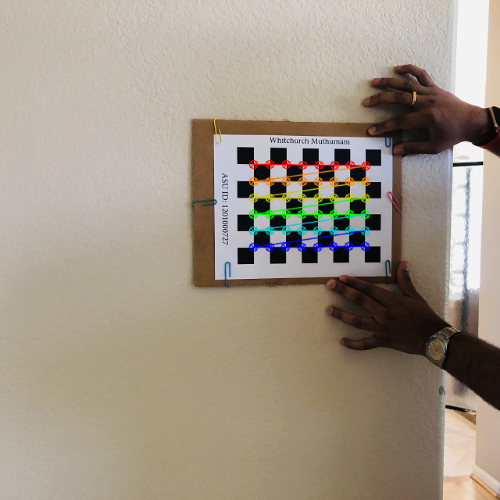

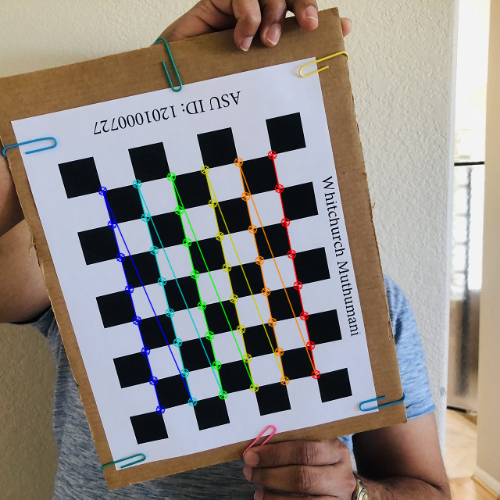

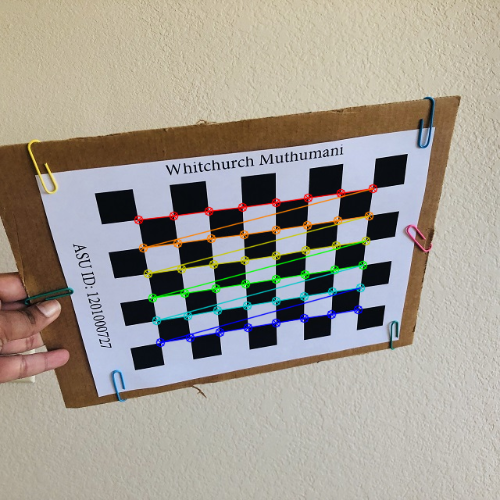

In [ ]:
for fname in images_1:
    # read image
    # TODO Part A (1): read the image from "fname" using cv2 imread
    img = cv2.imread(fname)
    
    # TODO Part A (2): convert img to gray scale using cvtColor using cv2.COLOR_BGR2GRAY parameter
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
   
    # Find the chess board corners
    # TODO Part A (3): find chess board corners using cv2 findChessboardCorners function, with "gray", grid size
    ret, corners = cv2.findChessboardCorners(gray,(8,6),None)
    
    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)

        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(corners2)

        # Draw and display the corners
        # TODO Part A (6): find chess board corners using cv2 findChessboardCorners function, with "img", grid size, corners2, and ret as parameters
        img = cv2.drawChessboardCorners(img,(8,6),corners2,ret)
        img = cv2.resize (img, (500, 500))
        # TODO Part A (4): display the image using cv2_imshow
        cv2_imshow(img)
       
        

In [ ]:
# TODO Part A (5): Compute camera matrix using cv2 calibrateCamera with objpoints, imgpoints, gray.shape[::-1] as parameters
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints,imgpoints,gray.shape[::-1],None,None)


In [ ]:
img = cv2.imread(images[7])
h,  w = img.shape[:2]

# the new camera matrix is being computed to remove the distortion
newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))

# undistort
dst = cv2.undistort(img, mtx, dist, None, newcameramtx)

# crop the image
x,y,w,h = roi
dst = dst[y:y+h, x:x+w]
cv2.imwrite('calibresult.png',dst)

print('Camera matrix:')
print(mtx)

print('dist')
print(dist)

print('rvecs')
print(rvecs)

print('tvecs')
print(tvecs)


Camera matrix:
[[706.44293341   0.         332.81686943]
 [  0.         705.94349571 305.2155378 ]
 [  0.           0.           1.        ]]
dist
[[ 3.55054866e-01 -2.41990287e+00 -5.23448902e-03  4.48001854e-03
   5.99452306e+00]]
rvecs
(array([[-0.17564361],
       [-0.38583965],
       [-0.49566353]]), array([[-0.00648562],
       [-0.10558252],
       [-0.58572954]]), array([[ 0.0376261 ],
       [-0.72271356],
       [-0.06372532]]), array([[-0.53138806],
       [-0.2457237 ],
       [-0.52538502]]), array([[-0.27354682],
       [-0.24026119],
       [-0.41282206]]), array([[ 0.46986193],
       [ 0.04683387],
       [-0.36168834]]), array([[ 0.03830064],
       [-0.24336711],
       [-0.33692755]]), array([[ 0.55366837],
       [ 0.33648694],
       [-0.53641006]]), array([[ 0.12868526],
       [-0.13653285],
       [-0.02313079]]), array([[-0.0022292 ],
       [-0.05550344],
       [-1.01480747]]), array([[-0.61187205],
       [-0.48189192],
       [-0.62916985]]), array([[0.41

In [ ]:
def draw(img, corners, imgpts):
    corner = tuple(corners[0].ravel())
    kk=tuple(imgpts[0].ravel().astype(int))
    print(tuple(imgpts[0].ravel().astype(int)))
    img = cv2.line(img, (int(corner[0]),int(corner[1])), tuple(imgpts[0].ravel().astype(int)), (255,0,0), 5)
    img = cv2.line(img, (int(corner[0]),int(corner[1])), tuple(imgpts[1].ravel().astype(int)), (0,255,0), 5)
    img = cv2.line(img, (int(corner[0]),int(corner[1])), tuple(imgpts[2].ravel().astype(int)), (0,0,255), 5)
    return img

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
objp = np.zeros((6*8,3), np.float32)
objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)
axis = np.float32([[3,0,0], [0,3,0], [0,0,-3]]).reshape(-1,3)
print ('done')


done


rvecs
[[-0.17564361]
 [-0.38583965]
 [-0.49566353]]
tvecs
[[-4.30985783]
 [-0.43202879]
 [18.36639459]]
whitchurchimages/Whitchurch_12.jpg
UNITS of DISTANCE is INCHES
dist: 18.87024042363129 inches
18.87024042363129
(264, 242)


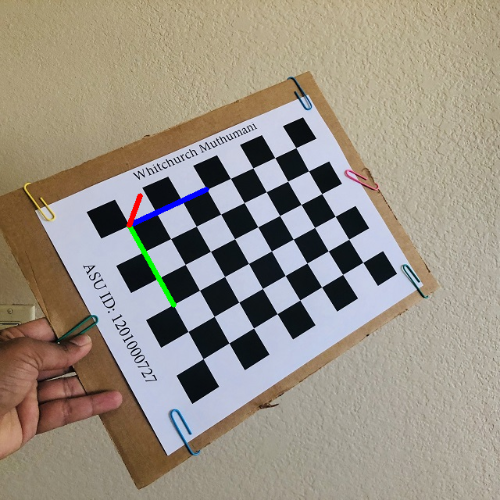

rvecs
[[-0.00648562]
 [-0.10558252]
 [-0.58572954]]
tvecs
[[-3.48606903]
 [ 0.67572812]
 [15.10847876]]
whitchurchimages/Whitchurch_9.jpg
UNITS of DISTANCE is INCHES
dist: 15.520161606059899 inches
15.520161606059899
(286, 260)


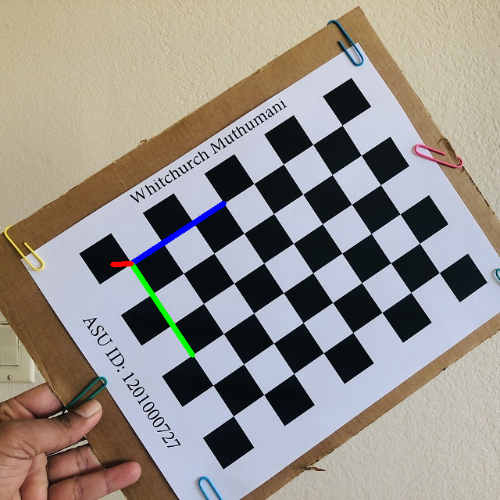

rvecs
[[ 0.0376261 ]
 [-0.72271356]
 [-0.06372532]]
tvecs
[[-3.86560087]
 [-1.22034055]
 [17.53304145]]
whitchurchimages/Whitchurch_8.jpg
UNITS of DISTANCE is INCHES
dist: 17.995545102618834 inches
17.995545102618834
(273, 253)


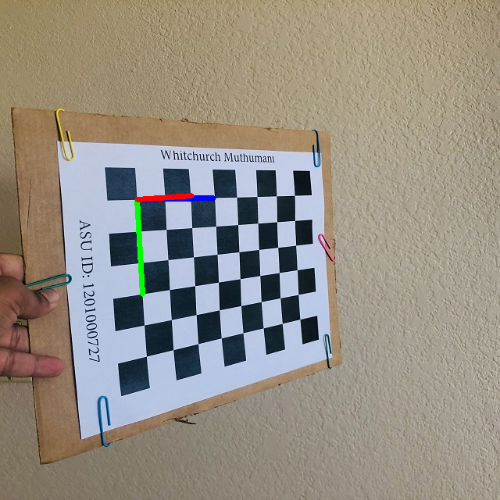

rvecs
[[-0.53138806]
 [-0.2457237 ]
 [-0.52538502]]
tvecs
[[-4.17819907]
 [-1.37096427]
 [19.75534848]]
whitchurchimages/Whitchurch_7.jpg
UNITS of DISTANCE is INCHES
dist: 20.238840971377357 inches
20.238840971377357
(276, 216)


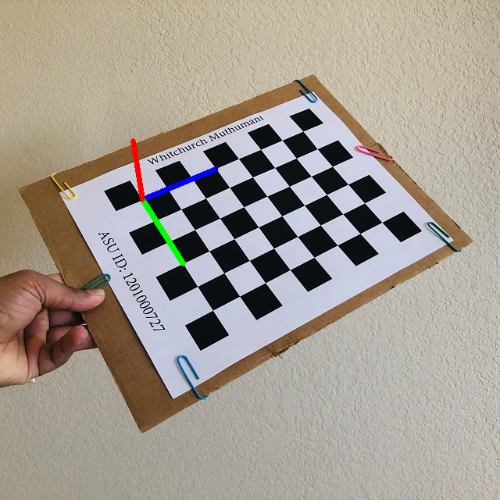

rvecs
[[-0.27354682]
 [-0.24026119]
 [-0.41282206]]
tvecs
[[-3.6827491 ]
 [-1.18809516]
 [18.88066288]]
whitchurchimages/Whitchurch_6.jpg
UNITS of DISTANCE is INCHES
dist: 19.273132643994142 inches
19.273132643994142
(296, 223)


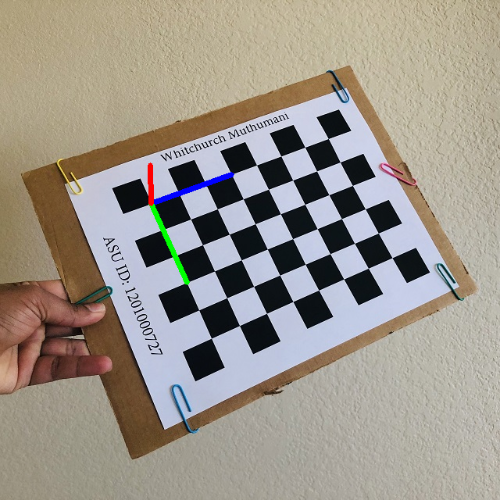

rvecs
[[ 0.46986193]
 [ 0.04683387]
 [-0.36168834]]
tvecs
[[-3.66371542]
 [-1.24458378]
 [17.72163247]]
whitchurchimages/Whitchurch_4.jpg
UNITS of DISTANCE is INCHES
dist: 18.139130541342794 inches
18.139130541342794
(297, 213)


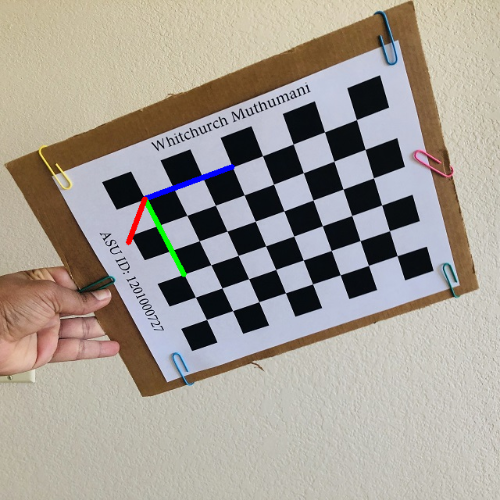

rvecs
[[ 0.03830064]
 [-0.24336711]
 [-0.33692755]]
tvecs
[[-4.19941484]
 [-1.91790618]
 [18.81231514]]
whitchurchimages/Whitchurch_5.jpg
UNITS of DISTANCE is INCHES
dist: 19.370509803384344 inches
19.370509803384344
(279, 198)


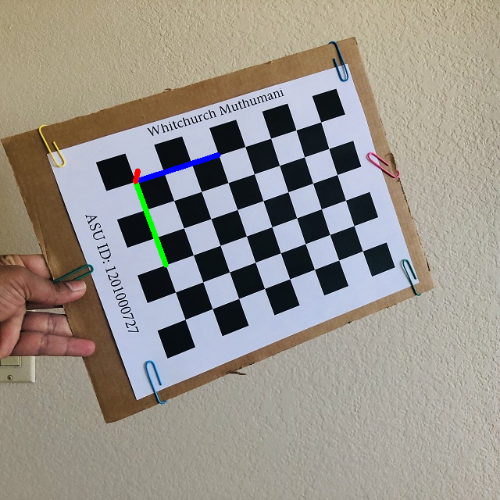

rvecs
[[ 0.55366837]
 [ 0.33648694]
 [-0.53641006]]
tvecs
[[-3.24460115]
 [-1.18350417]
 [17.58292886]]
whitchurchimages/Whitchurch_3.jpg
UNITS of DISTANCE is INCHES
dist: 17.918914758213305 inches
17.918914758213305
(297, 202)


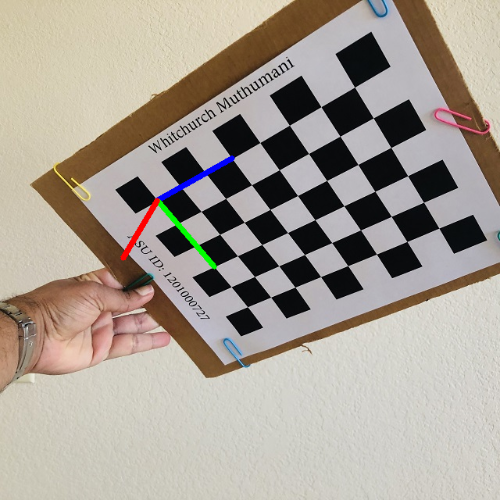

rvecs
[[ 0.12868526]
 [-0.13653285]
 [-0.02313079]]
tvecs
[[-2.46976471]
 [-2.11807794]
 [19.71477146]]
whitchurchimages/Whitchurch_1.jpg
UNITS of DISTANCE is INCHES
dist: 19.981446532148148 inches
19.981446532148148
(350, 227)


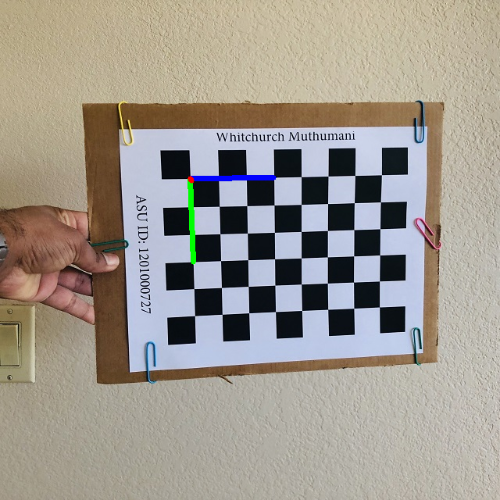

rvecs
[[-0.00222925]
 [-0.05550342]
 [-1.01480747]]
tvecs
[[-4.59586868]
 [ 2.32181601]
 [15.67282902]]
whitchurchimages/Whitchurch_15.jpg
UNITS of DISTANCE is INCHES
dist: 16.496981788096058 inches
16.496981788096058
(197, 294)


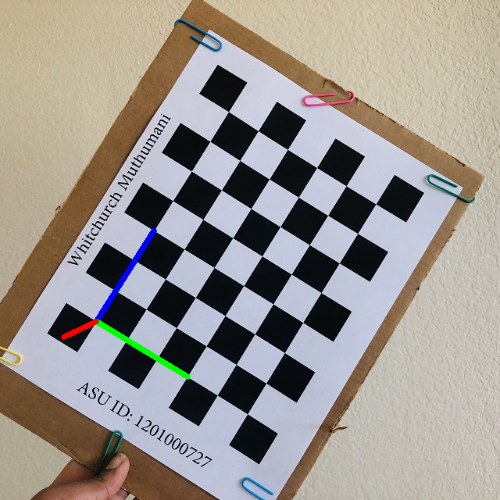

rvecs
[[-0.61187205]
 [-0.48189192]
 [-0.62916985]]
tvecs
[[-4.39999864]
 [ 0.68458354]
 [19.79812936]]
whitchurchimages/Whitchurch_13.jpg
UNITS of DISTANCE is INCHES
dist: 20.29272206570427 inches
20.29272206570427
(258, 288)


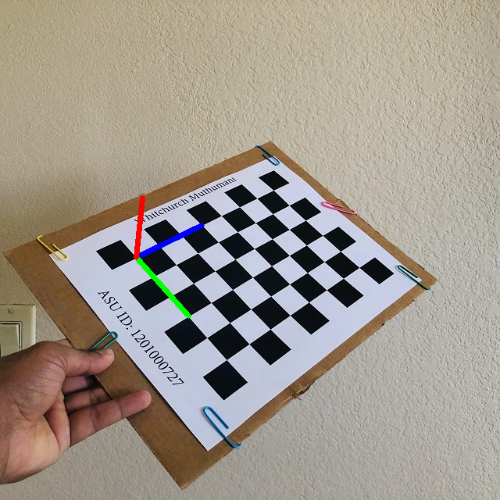

rvecs
[[0.41280301]
 [0.2947614 ]
 [0.86023467]]
tvecs
[[ 9.61558984e-03]
 [-2.34576299e+00]
 [ 1.41078295e+01]]
whitchurchimages/Whitchurch_14.jpg
UNITS of DISTANCE is INCHES
dist: 14.301522595336642 inches
14.301522595336642
(428, 304)


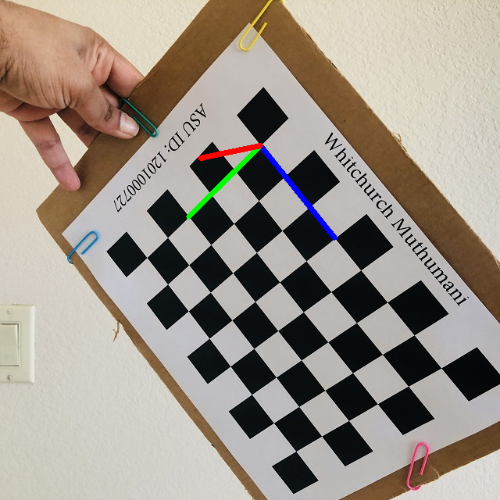

rvecs
[[ 0.08384592]
 [-0.5553137 ]
 [-0.09641086]]
tvecs
[[-2.58106225]
 [-3.00307305]
 [20.29738722]]
whitchurchimages/Whitchurch_2.jpg
UNITS of DISTANCE is INCHES
dist: 20.680044920508088 inches
20.680044920508088
(331, 196)


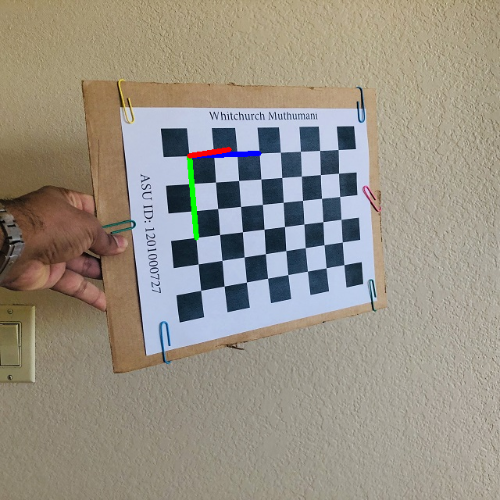

rvecs
[[ 0.04451317]
 [-0.17524213]
 [-0.00221602]]
tvecs
[[-0.39009141]
 [-4.46405795]
 [33.31736731]]
whitchurchimages/Whitchurch_16.jpg
UNITS of DISTANCE is INCHES
dist: 33.61736082779187 inches
33.61736082779187
(386, 210)


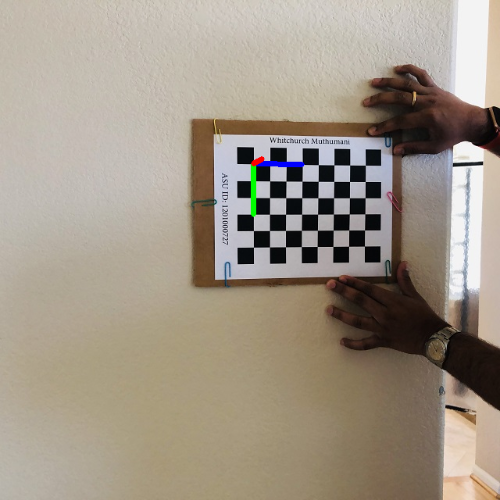

rvecs
[[ 0.11963702]
 [-0.18717112]
 [ 1.35508488]]
tvecs
[[ 0.34548143]
 [-2.4234892 ]
 [16.18378844]]
whitchurchimages/Whitchurch_17.jpg
UNITS of DISTANCE is INCHES
dist: 16.36788519105454 inches
16.36788519105454
(372, 324)


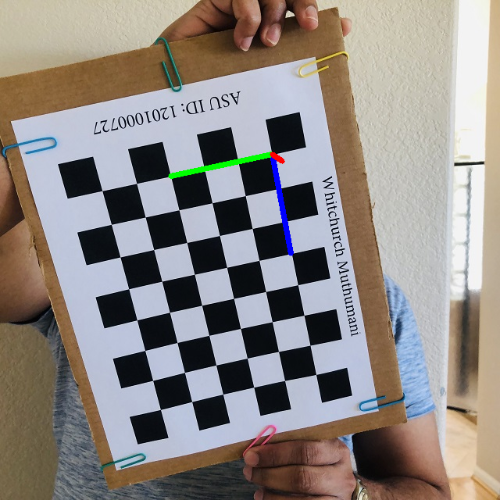

rvecs
[[ 0.63184404]
 [-0.19899916]
 [-0.08644123]]
tvecs
[[-3.4580866 ]
 [-0.52185201]
 [15.80159607]]
whitchurchimages/Whitchurch_11.jpg
UNITS of DISTANCE is INCHES
dist: 16.183977595875113 inches
16.183977595875113
(309, 264)


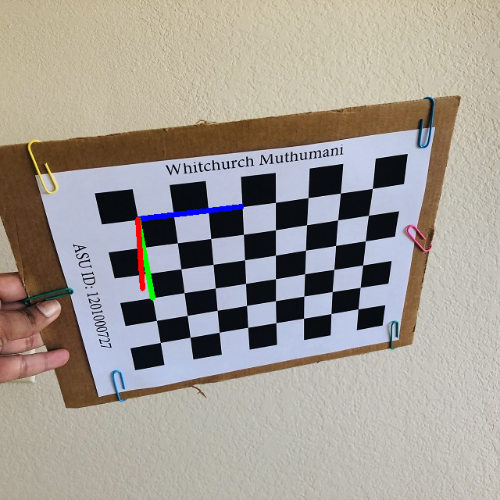

In [ ]:
for fname in images:
    # read image
    # TODO Part A (1): read the image from "fname" using cv2 imread
    img = cv2.imread(fname)
   
    # TODO Part A (2): convert img to gray scale using cvtColor using cv2.COLOR_BGR2GRAY parameter
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chess board corners
    # TODO Part A (3): find chess board corners using cv2 findChessboardCorners function, with "gray", grid size
    ret, corners = cv2.findChessboardCorners(gray,(8,6),None)

    if ret == True:
        corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        
        # Find the rotation and translation vectors.
        # TODO Part A (7): Find rotation and translation matrix by calling cv2.solvePnP using objp, corners2, mtx and dist as parameters
        ret,rvecs, tvecs = cv2.solvePnP(objp,corners2,mtx,dist)

        print('rvecs')
        print(rvecs)

        print('tvecs')
        print(tvecs)
        
        # TODO Part B: Print the distance from the camera using np linalg norm function with tvecs as input and mention the unit of measurement in pdf
        print(fname)
        print('UNITS of DISTANCE is INCHES')
        print('dist: ' + str(np.linalg.norm(tvecs, ord=None, axis=None, keepdims=False))+' inches')
        print(np.linalg.norm(tvecs, ord=None, axis=None, keepdims=False))
        # project 3D points to image plane
        imgpts, jac = cv2.projectPoints(axis, rvecs, tvecs, mtx, dist)
        img = draw(img,corners2,imgpts)
        img = cv2.resize (img, (500, 500))
        # TODO Part A (4): display the image using cv2_imshow

        cv2_imshow(img)
